# Part 1: Find tables 

In [1]:
import numpy as np
import pandas as pd
import pickle
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage import io
from skimage.feature import canny
import cv2
import imutils
from sklearn.metrics import accuracy_score
from torch.utils.data import Dataset, DataLoader

import random
from pathlib import Path
import warnings
import os
import torch
from torchvision import transforms
warnings.filterwarnings(action='ignore', category=DeprecationWarning)

from sklearn.preprocessing import LabelEncoder
import torch.nn as nn
from tqdm import tqdm, tqdm_notebook


np.random.seed(42)
torch.manual_seed(42)
torch.cuda.manual_seed(42)
torch.backends.cudnn.deterministic = True


%matplotlib inline

In [2]:
def show(img, cmap='gray'):
    """
    function to plot image
    """
    
    plt.figure(figsize=(14,8))
    plt.imshow(img, cmap=cmap)
    #plt.axis('off')
    plt.show()

In [3]:
img_gray  = cv2.cvtColor(cv2.imread('./train_0.jpg'), cv2.COLOR_RGB2GRAY)

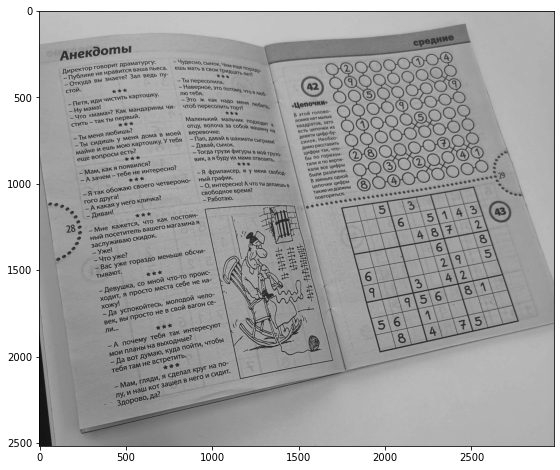

In [4]:
show(img_gray)

In [5]:
from ipywidgets import IntSlider, interact
sld1 = IntSlider(value=5, min=1, max=21, step=2, continuous_update=False)
sld2 = IntSlider(value=11, min=1, max=301, step=2, continuous_update=False)
sld3 = IntSlider(value=15, min=1, max=30, step=1, continuous_update=False)


def vary_thresh_parameters(kernel_size, size, C, use_cv2=False):
    if use_cv2:
        blurred = cv2.GaussianBlur(img_gray, (kernel_size, kernel_size), 0)
        show(cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, size, C))
    else:
        show(cv2.adaptiveThreshold(gray_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, size, C))

In [6]:
interact(vary_thresh_parameters, kernel_size=sld1, size=sld2, C=sld3, use_cv2=True);

interactive(children=(IntSlider(value=5, continuous_update=False, description='kernel_size', max=21, min=1, st…

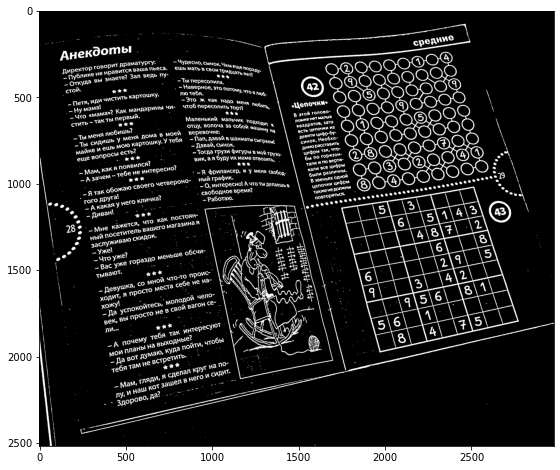

In [7]:
blurred = cv2.GaussianBlur(img_gray, (3, 3), 0)
show(cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 63, 14))

In [8]:
edges = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 63, 14)

<Figure size 900x600 with 0 Axes>

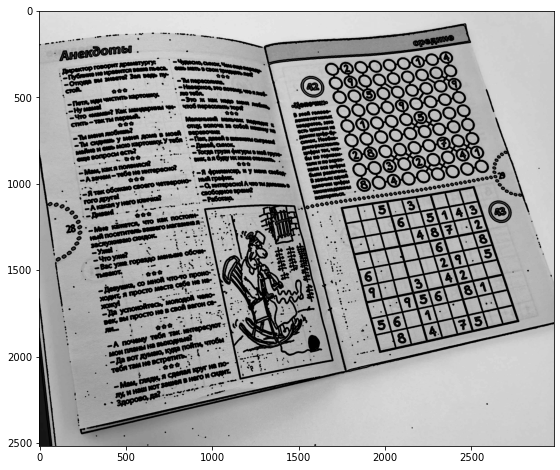

In [9]:
contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = img_gray.copy()
cv2.drawContours(img_cnt, contours, -1, (3,3,3), 5)
plt.figure(dpi=150)
show(img_cnt)

In [10]:
#we can compute area of each contour 
areas = (cv2.contourArea(cnt) for  cnt in contours)
#then exclude the first one = the whole image
areas = filter(lambda x: x[0] != 0, enumerate(areas))
#and select the largest one
cnt_id, area = max(areas, key=lambda x: x[1])
cnt_id, area

(1660, 670915.0)

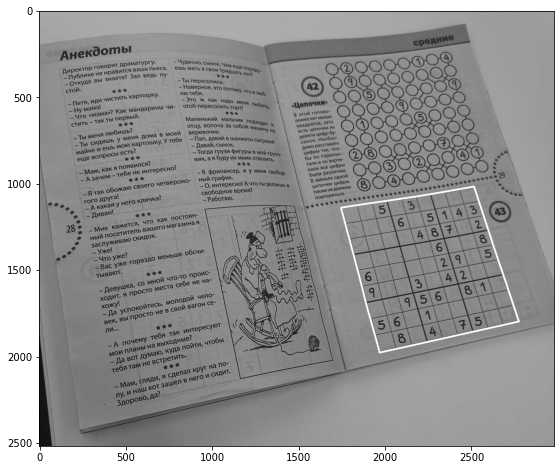

In [11]:
img_1_cnt = img_gray.copy()
cv2.drawContours(img_1_cnt, contours, cnt_id, (255,255,255), 10)

show(img_1_cnt)

In [12]:
# edged is the edge detected image
cnts = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
cnts = sorted(cnts, key = cv2.contourArea, reverse = True)

In [13]:
cnts[0]

array([[[2511, 1015]],

       [[2510, 1016]],

       [[2507, 1016]],

       ...,

       [[2515, 1018]],

       [[2513, 1016]],

       [[2512, 1016]]], dtype=int32)

In [14]:
peri = cv2.arcLength(cnts[0], True)
peri

3512.743413925171

In [15]:
approx = cv2.approxPolyDP(cnts[0], 0.02 * peri, True)

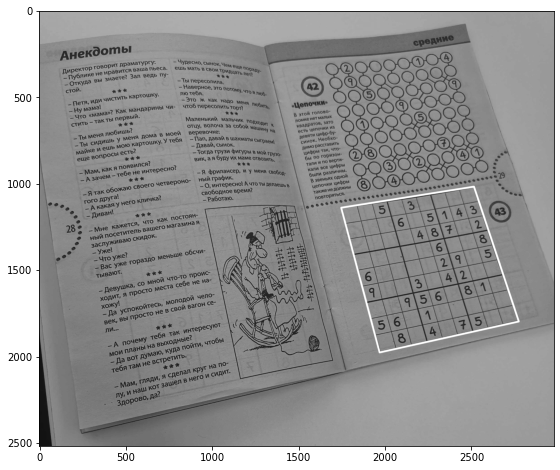

In [16]:
img_1_cnt = img_gray.copy()
cv2.drawContours(img_1_cnt, [approx], 0, (255,255,255), 10)

show(img_1_cnt)


In [17]:
import os
images = {}

for img in os.listdir('./'):
    if img[-4:] == '.jpg':
        print(f' Loading: {img}')
        images[img]  = cv2.cvtColor(cv2.imread(f'./{img}'), cv2.COLOR_RGB2GRAY)
print('Completed')

 Loading: train_0.jpg
 Loading: train_1.jpg
 Loading: train_2.jpg
 Loading: train_3.jpg
 Loading: train_4.jpg
 Loading: train_5.jpg
 Loading: train_6.jpg
 Loading: train_7.jpg
 Loading: train_8.jpg
Completed


In [18]:
images['train_1.jpg']

array([[191, 191, 191, ..., 202, 202, 202],
       [191, 191, 191, ..., 202, 202, 202],
       [191, 191, 191, ..., 202, 202, 202],
       ...,
       [ 85,  85,  84, ...,  87,  67,  60],
       [ 88,  87,  87, ...,  96,  72,  62],
       [ 89,  89,  88, ..., 102,  75,  64]], dtype=uint8)

## Segmentation

train_1.jpg


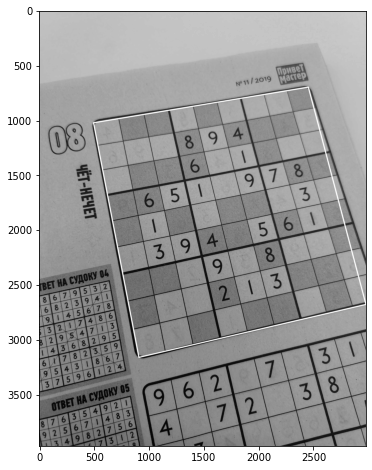

In [19]:
img_gray = images[f'train_1.jpg']
blurred = cv2.GaussianBlur(img_gray, (1, 1), 0)
edges = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 63, 14)

contours = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(contours)
cnts = sorted(cnts, key = cv2.contourArea, reverse = True)

peri = cv2.arcLength(cnts[0], True)
approx = cv2.approxPolyDP(cnts[0], 0.1 * peri, True)

img_1_cnt = img_gray.copy()
cv2.drawContours(img_1_cnt, [approx], 0, (255,0,0), 10)
    
print(f'train_1.jpg')
show(img_1_cnt)

In [20]:
mask = np.zeros_like(img_1_cnt) # Create mask where white is what we want, black otherwise
cv2.drawContours(mask, [approx], 0, 255, -1) # Draw filled contour in mask
out = np.zeros_like(img_1_cnt) # Extract out the object and place into output image
out[mask == 255] = img_1_cnt[mask == 255]




In [21]:
out

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [22]:
out_bol = np.array(out, dtype=bool)

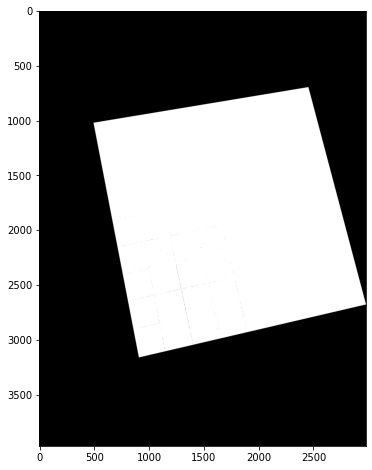

In [23]:
show(out_bol)

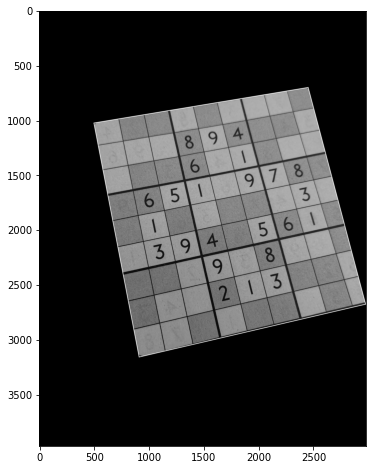

In [24]:
show(out)

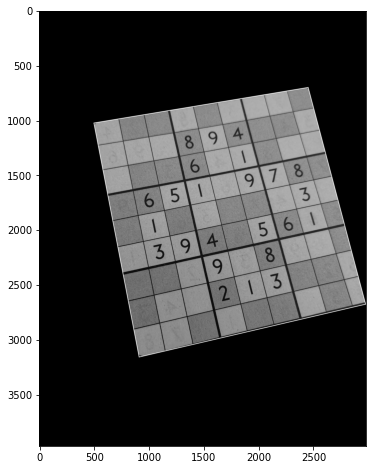

In [25]:
show(out)

train_0.jpg


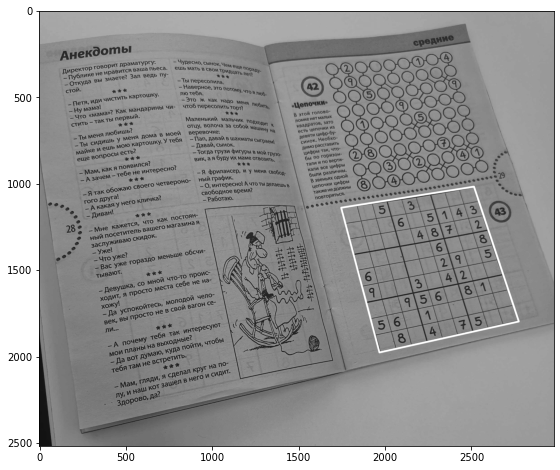

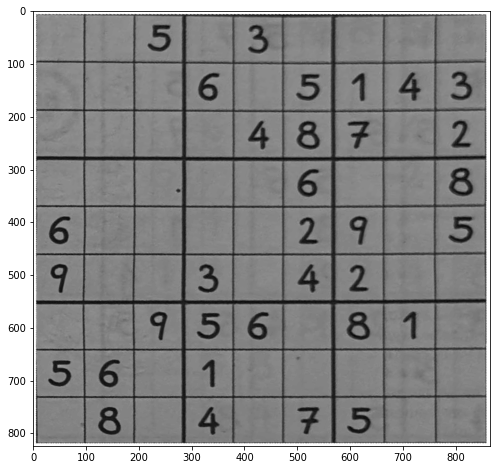

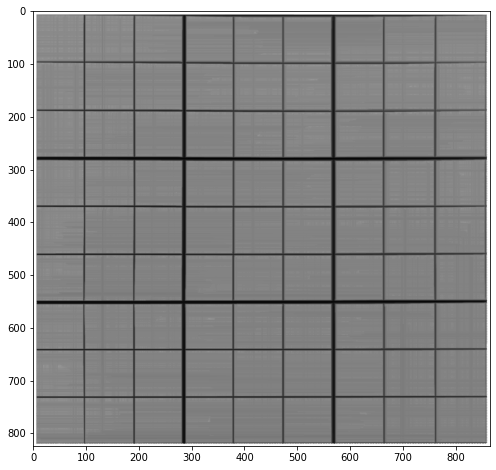

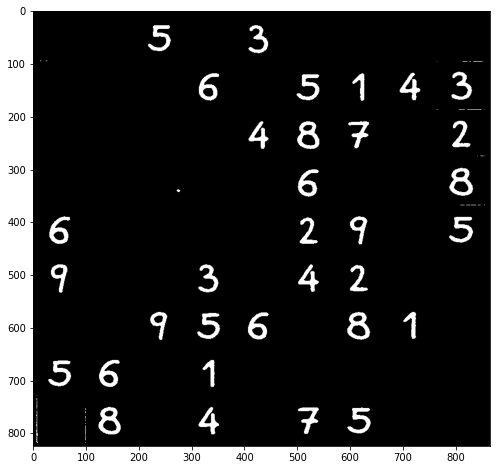

train_1.jpg


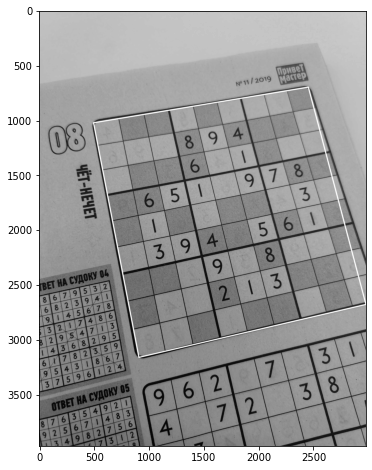

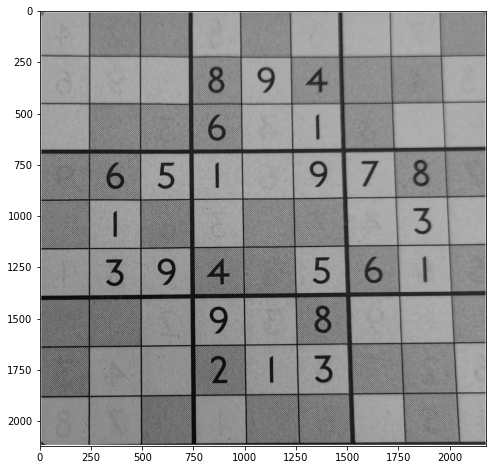

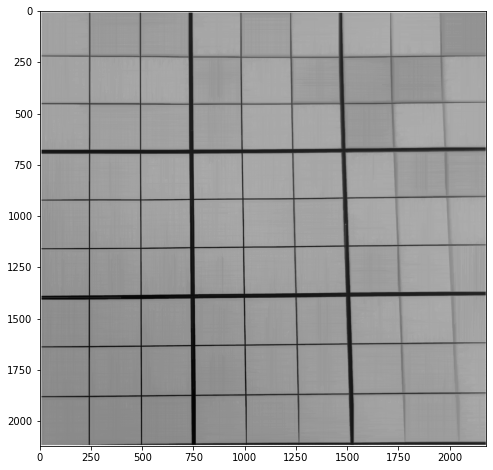

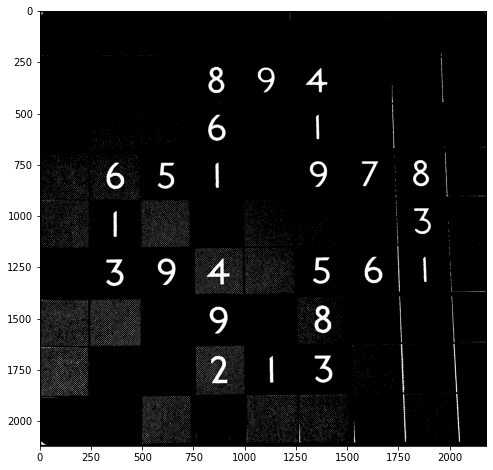

train_2.jpg


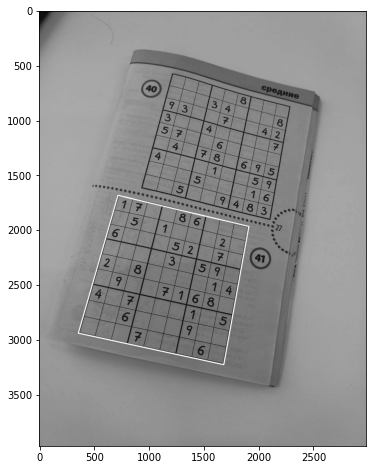

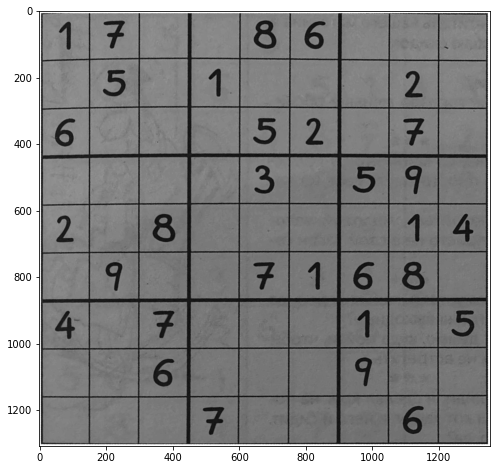

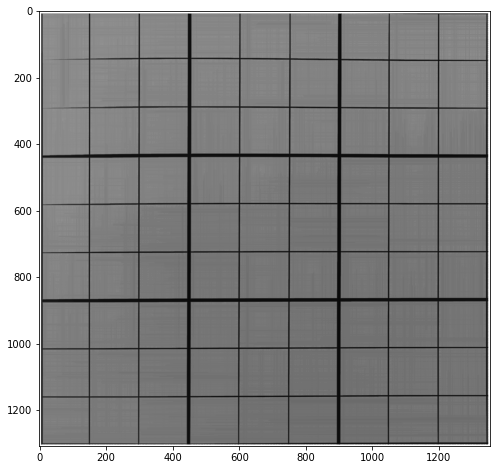

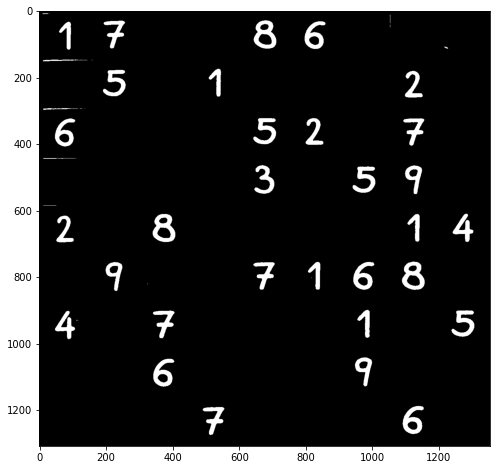

train_3.jpg


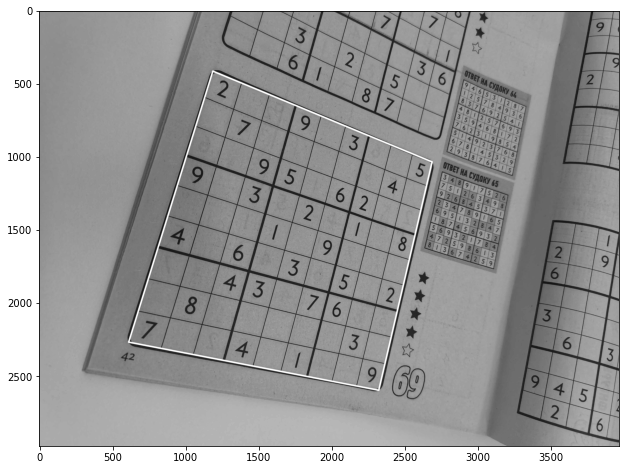

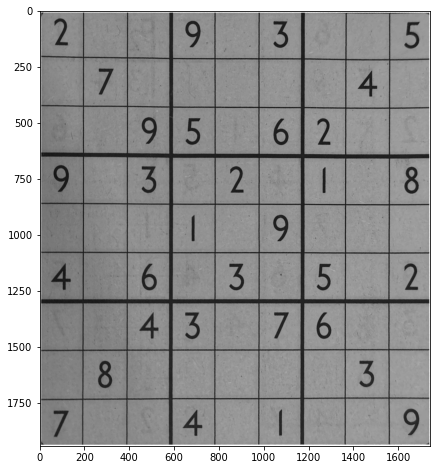

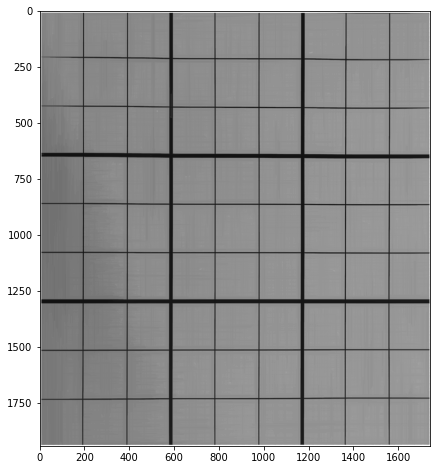

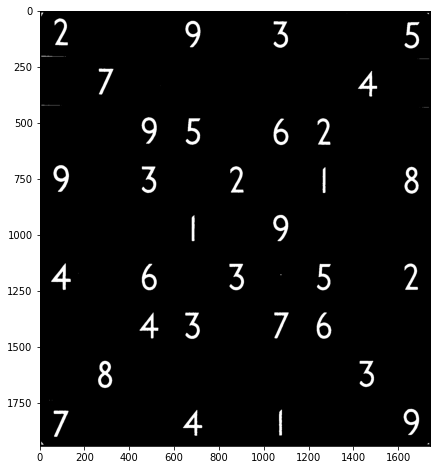

train_4.jpg


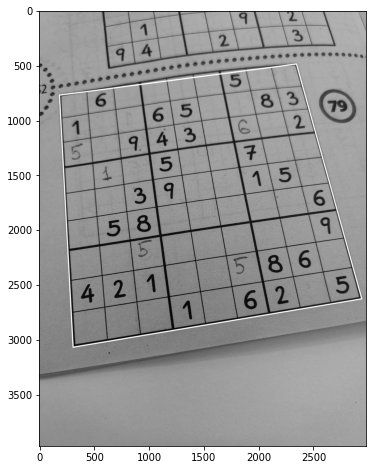

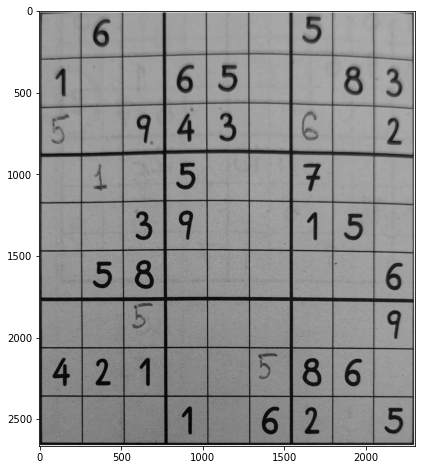

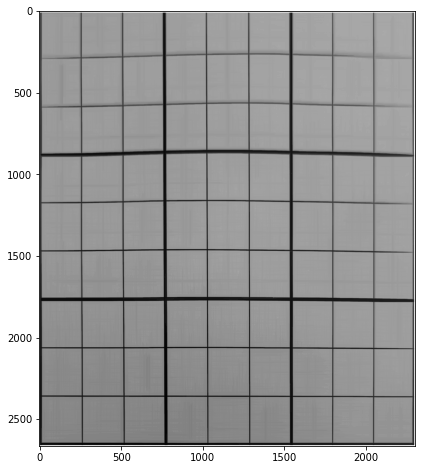

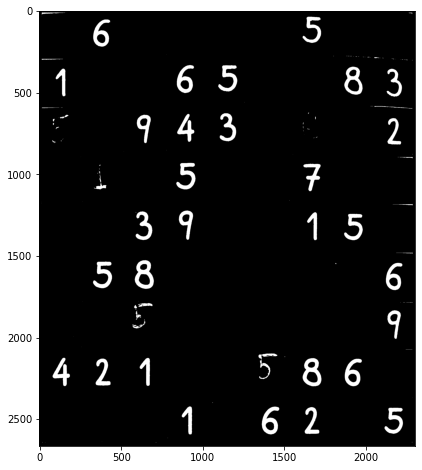

train_5.jpg


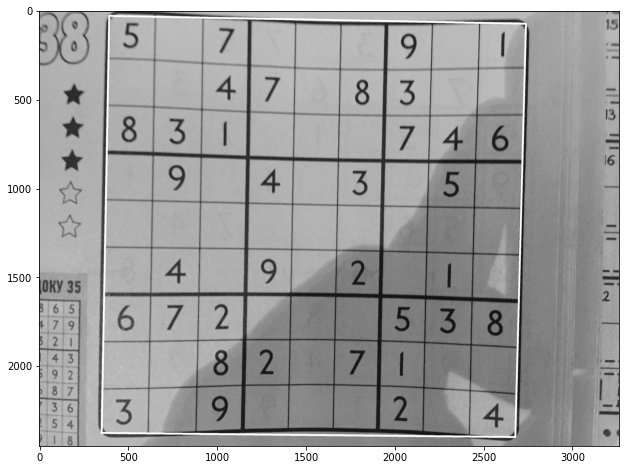

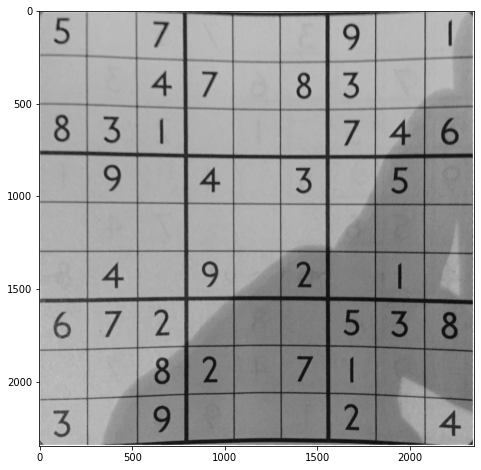

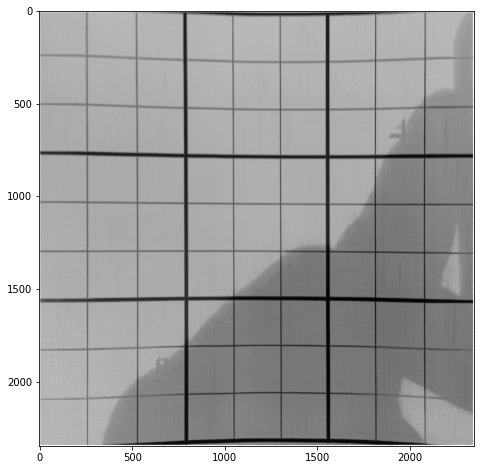

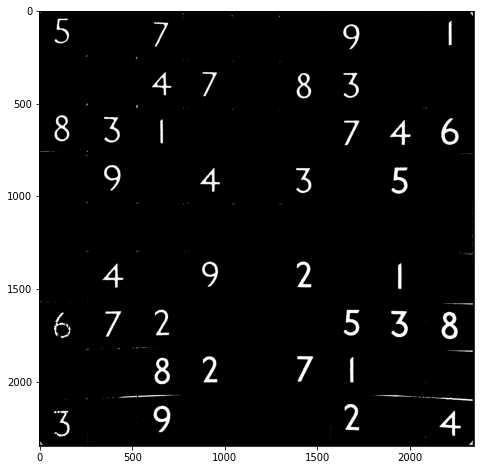

train_6.jpg


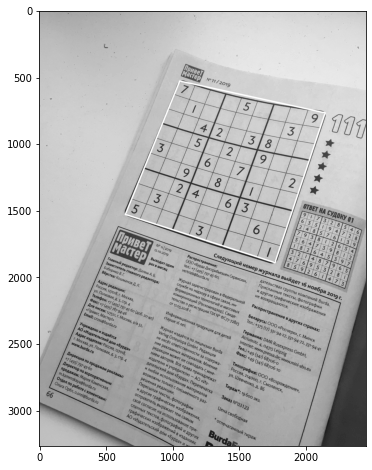

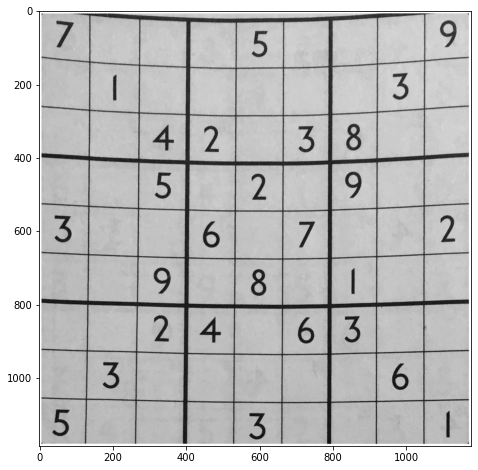

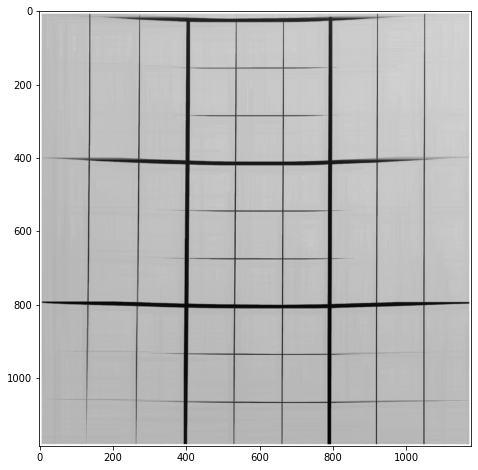

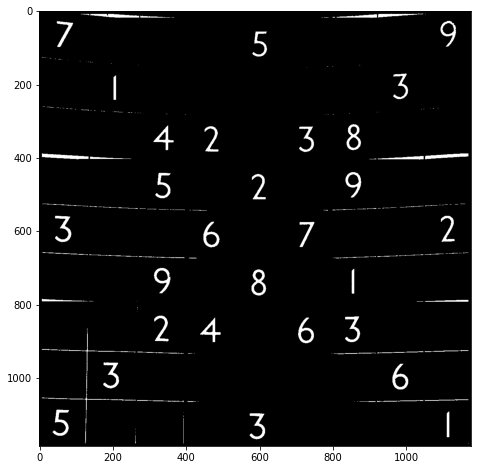

train_7.jpg


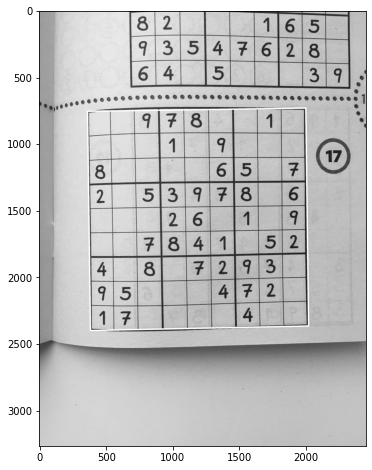

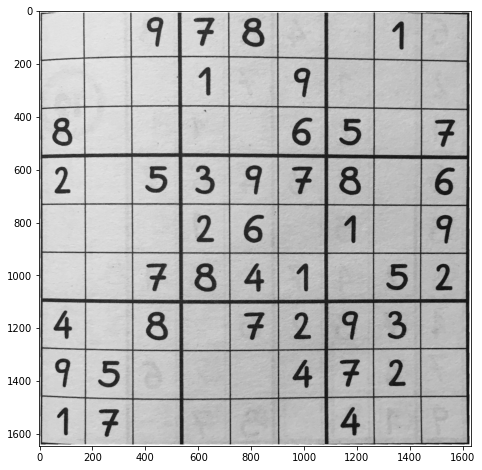

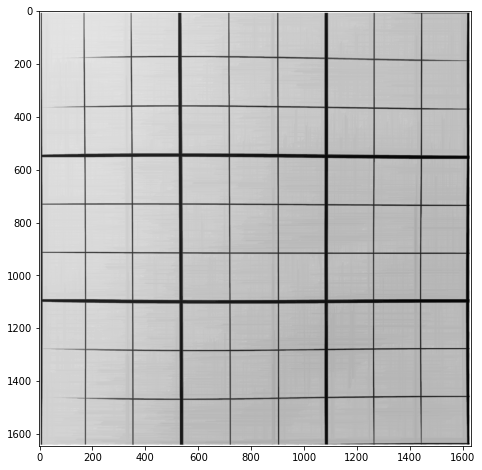

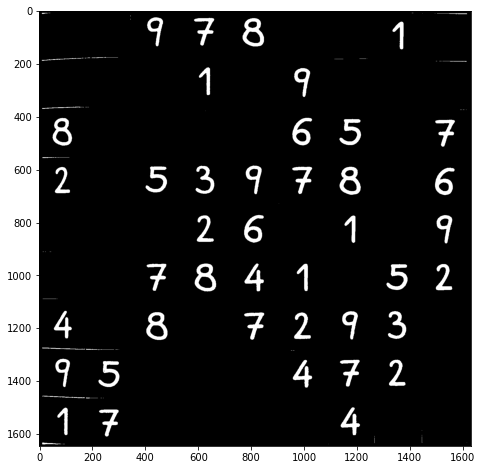

train_8.jpg


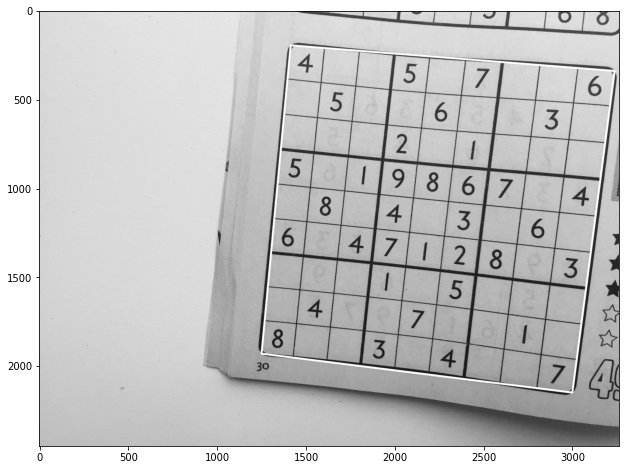

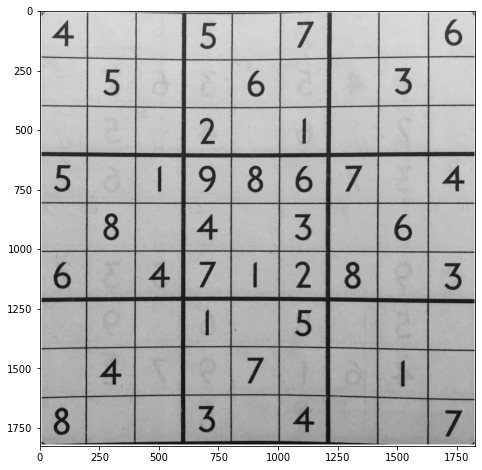

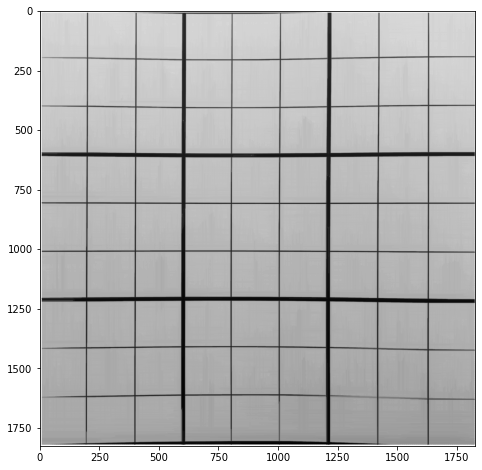

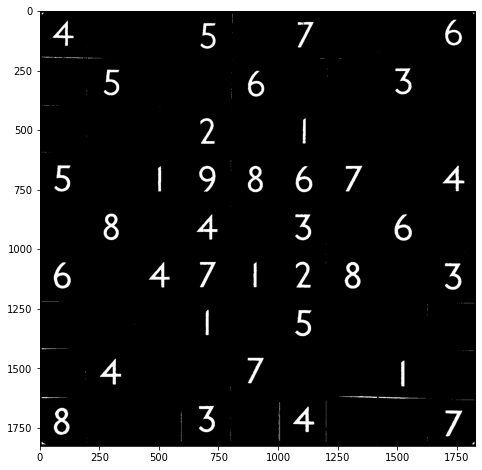

In [26]:
i, photos = 0, {}
while i < 9:
    img_gray = images[f'train_{i}.jpg']
    blurred = cv2.GaussianBlur(img_gray, (1, 1), 0)
    edges = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 63, 14)

    contours = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(contours)
    cnts = sorted(cnts, key = cv2.contourArea, reverse = True)

    peri = cv2.arcLength(cnts[0], True)
    approx = cv2.approxPolyDP(cnts[0], 0.1 * peri, True)

    img_1_cnt = img_gray.copy()
    cv2.drawContours(img_1_cnt, [approx], 0, (255,0,0), 10)
    
    print(f'train_{i}.jpg')
    show(img_1_cnt)
    
    #Projective transform
    pt_A = approx[0][0]
    pt_B = approx[1][0]
    pt_C = approx[2][0]
    pt_D = approx[3][0]
    
    #L2 norm
    width_AD = np.sqrt(((pt_A[0] - pt_D[0]) ** 2) + ((pt_A[1] - pt_D[1]) ** 2))
    width_BC = np.sqrt(((pt_B[0] - pt_C[0]) ** 2) + ((pt_B[1] - pt_C[1]) ** 2))
    maxWidth = max(int(width_AD), int(width_BC))

    height_AB = np.sqrt(((pt_A[0] - pt_B[0]) ** 2) + ((pt_A[1] - pt_B[1]) ** 2))
    height_CD = np.sqrt(((pt_C[0] - pt_D[0]) ** 2) + ((pt_C[1] - pt_D[1]) ** 2))
    maxHeight = max(int(height_AB), int(height_CD))
    
    if pt_A[0] < pt_C[0]:
        input_pts = np.float32([pt_A, pt_B, pt_C, pt_D])
    
    elif pt_A[1] < pt_D[1]:
        input_pts = np.float32([pt_B, pt_C, pt_D, pt_A])
        
    else:
        input_pts = np.float32([pt_A, pt_B, pt_C, pt_D])
    
    output_pts = np.float32([[0, 0], [0, maxHeight - 1], [maxWidth - 1, maxHeight - 1], [maxWidth - 1, 0]])
    
    # Compute the perspective transform M
    M = cv2.getPerspectiveTransform(input_pts,output_pts)
    
    out = cv2.warpPerspective(img_1_cnt,M,(maxWidth, maxHeight),flags=cv2.INTER_LINEAR)
    
    show(out)
    
    # morphology to remove boarders
    kernel = np.ones((200, 1),np.uint8)
    closing_vert = cv2.morphologyEx(np.uint8(out), cv2.MORPH_CLOSE, kernel) # detect vertical lines
    kernel = np.ones((1, 200),np.uint8)
    closing_hor = cv2.morphologyEx(np.uint8(out), cv2.MORPH_CLOSE, kernel) # horizontal lines
    
    a = out.copy()
    mask = np.min([closing_hor, closing_vert], axis = 0)
    a[mask < 110] = 255
    kernel_size = 3
    show(mask)
    blurred = cv2.GaussianBlur(a, (kernel_size, kernel_size), 0)
    show(blurred < 82)
    photos[f'train_{i}.jpg'] = (blurred < 82).astype(np.uint8)
    i += 1  

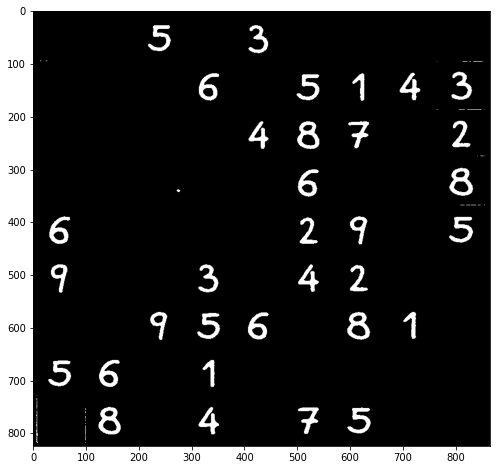

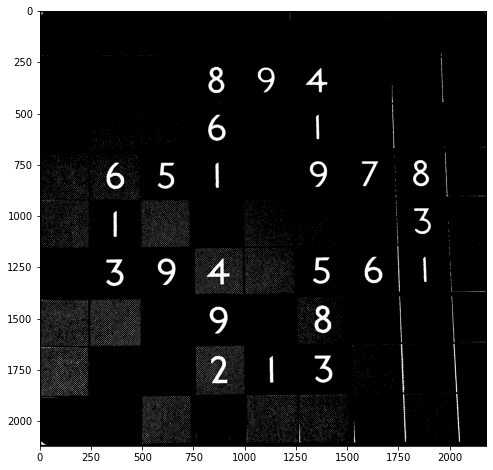

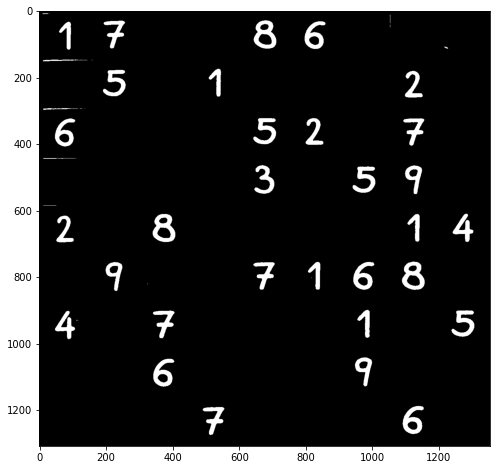

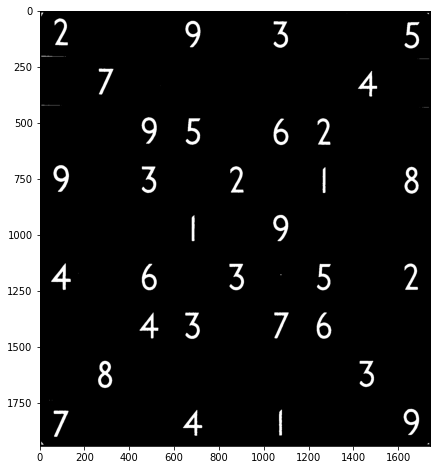

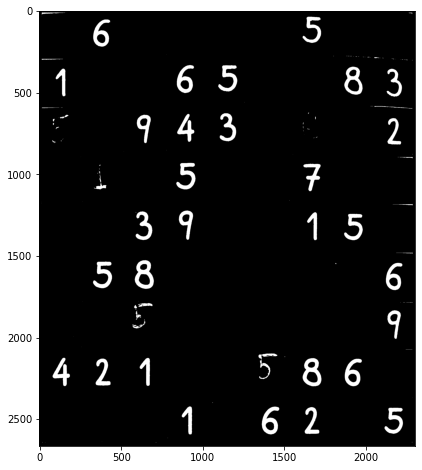

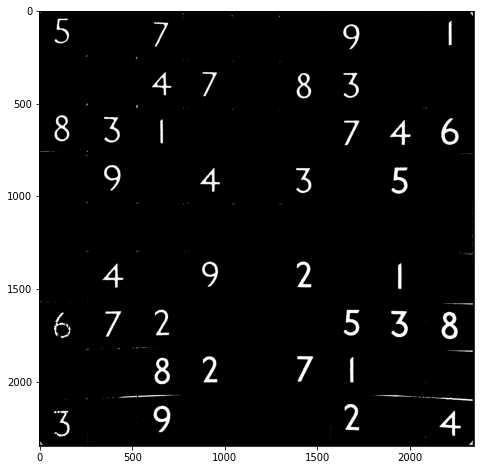

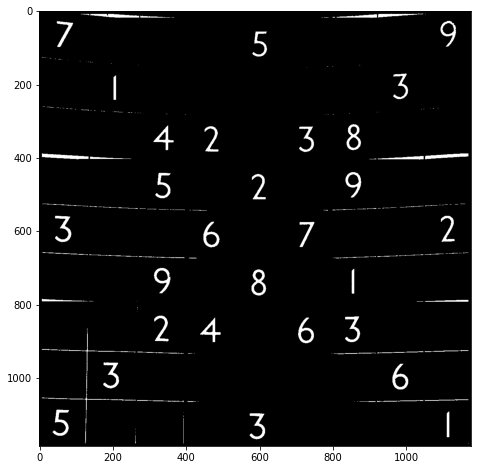

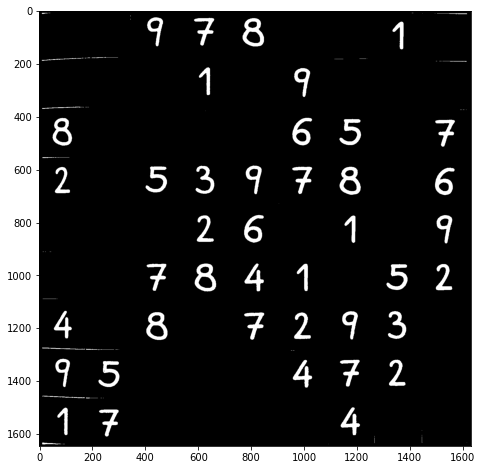

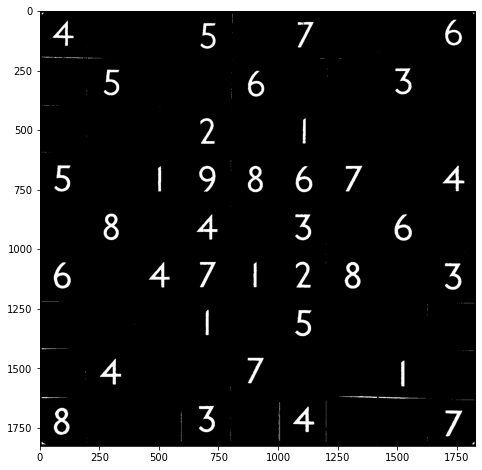

In [27]:
for i in range(9):
    show(photos[f'train_{i}.jpg'])

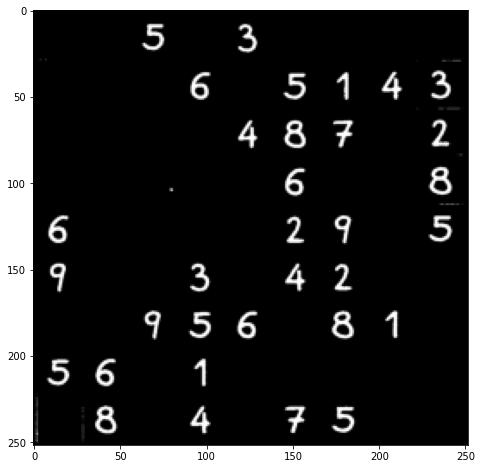

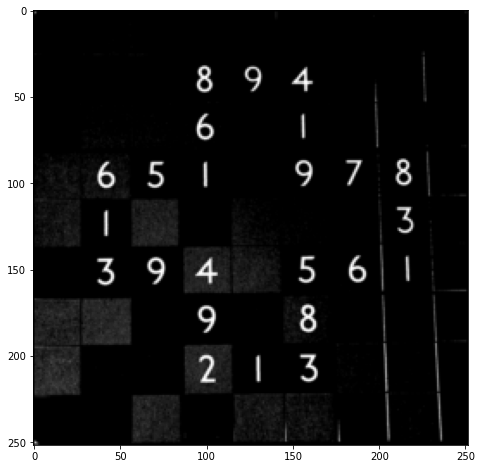

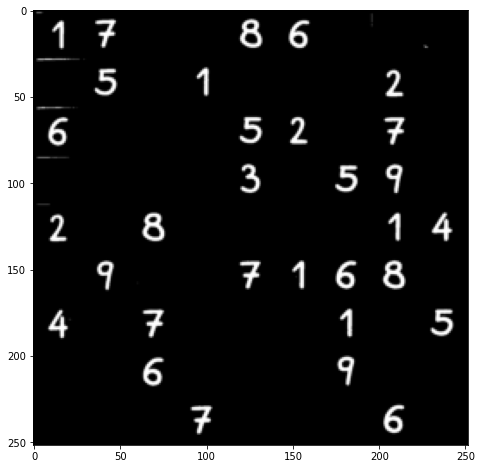

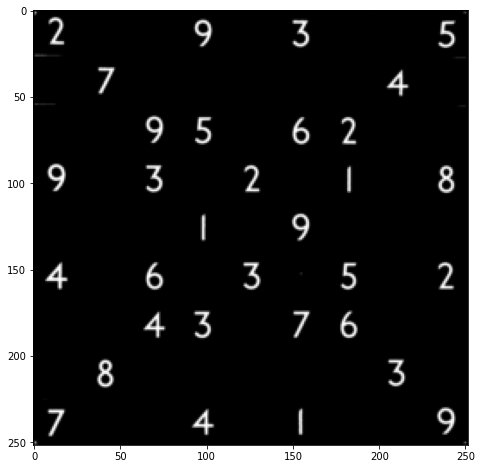

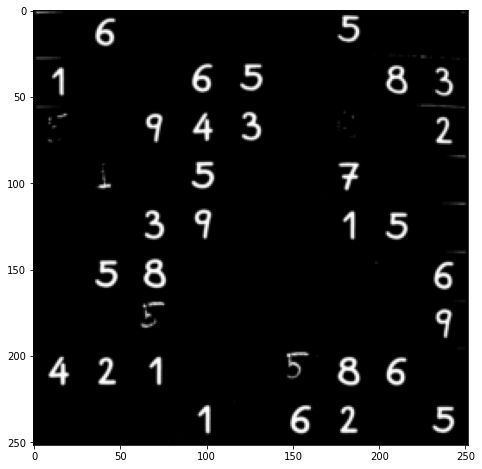

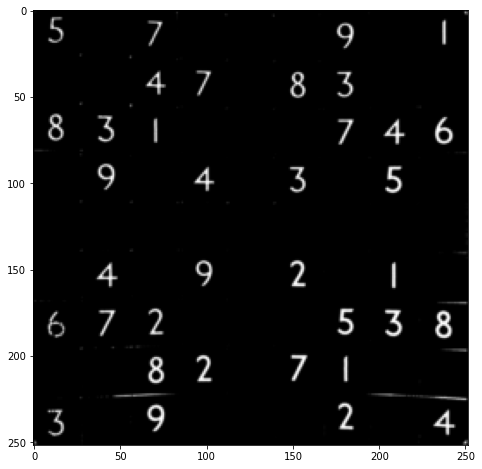

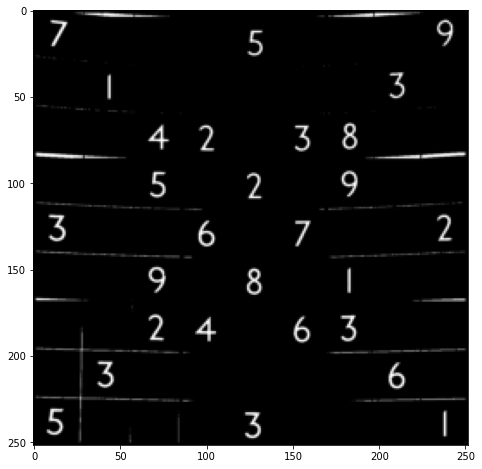

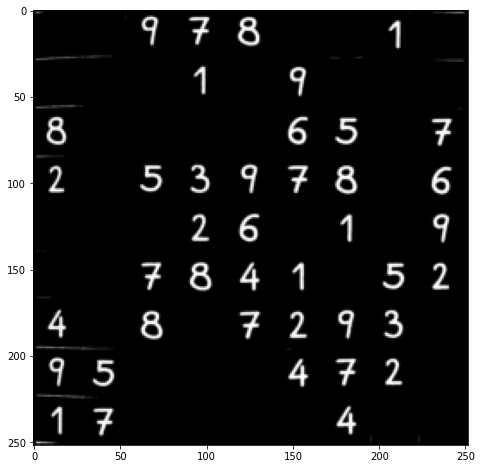

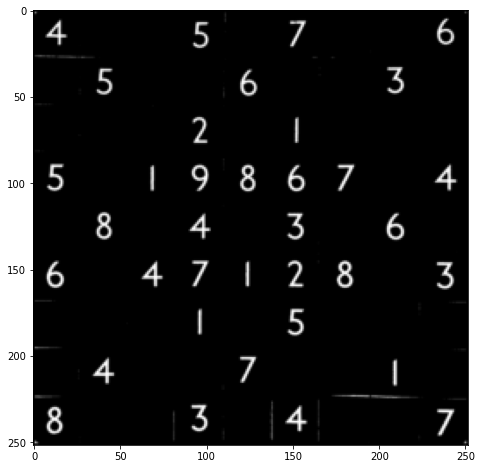

In [28]:
from skimage.transform import resize
resized = {}
for i in range(9):
    image_resized = resize(photos[f'train_{i}.jpg'], (252, 252), anti_aliasing=True)
    show(image_resized)
    resized[f'train_{i}.jpg'] = image_resized

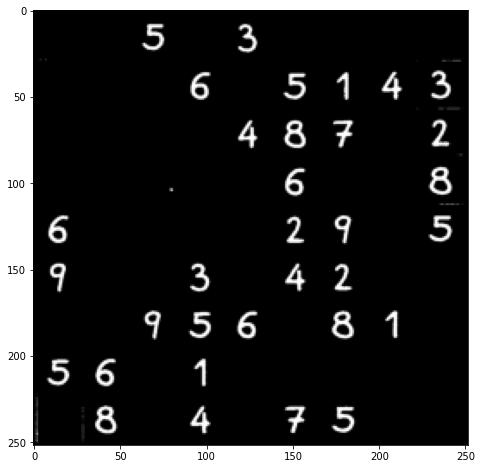

In [29]:
show(resized['train_0.jpg'])

In [30]:
by_digits = {}
for photo in resized.keys():
    dig_list = []
    for i in range(28, 253, 28):
        for j in range(28, 253, 28):
            dig_list.append(resized[photo][(i-28):i, (j-28):j])
    by_digits[photo] = dig_list

In [31]:
by_digits.keys()

dict_keys(['train_0.jpg', 'train_1.jpg', 'train_2.jpg', 'train_3.jpg', 'train_4.jpg', 'train_5.jpg', 'train_6.jpg', 'train_7.jpg', 'train_8.jpg'])

In [32]:
def ploy_by_digits(by_digits):
    fig, axs = plt.subplots(nrows=9, ncols=9, figsize=(9, 9))
    plt.subplots_adjust(hspace=0.5)

    for i in range(len(by_digits)):
        axs[int(i / 9), i % 9].imshow(by_digits[i], cmap = 'gray')
    
    plt.show()

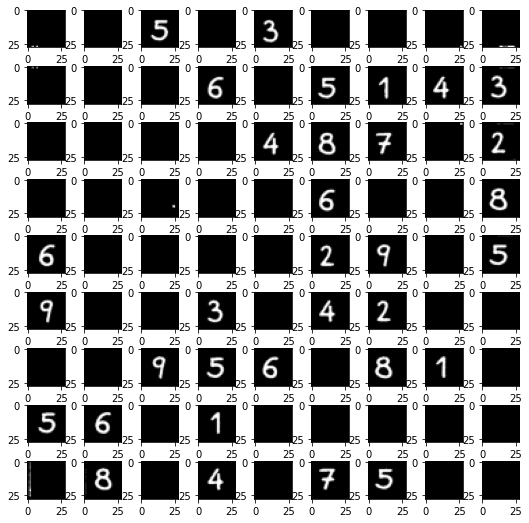

In [33]:
ploy_by_digits(by_digits['train_0.jpg'])

In [34]:
import json
def load_tester(path):
    with open(path) as f:
        data = json.load(f)
    return np.asarray(data)

In [35]:
train_0 = load_tester('./train_0_digits_0.json')
train_0

array([[-1, -1,  5, -1,  3, -1, -1, -1, -1],
       [-1, -1, -1,  6, -1,  5,  1,  4,  3],
       [-1, -1, -1, -1,  4,  8,  7, -1,  2],
       [-1, -1, -1, -1, -1,  6, -1, -1,  8],
       [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
       [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
       [-1, -1,  9,  5,  6, -1,  8,  1, -1],
       [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
       [-1,  8, -1,  4, -1,  7,  5, -1, -1]])

In [36]:
by_digits['train_0.jpg'][0][0]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [37]:
from skimage.feature import hog
from skimage import data, exposure
from skimage.transform import resize

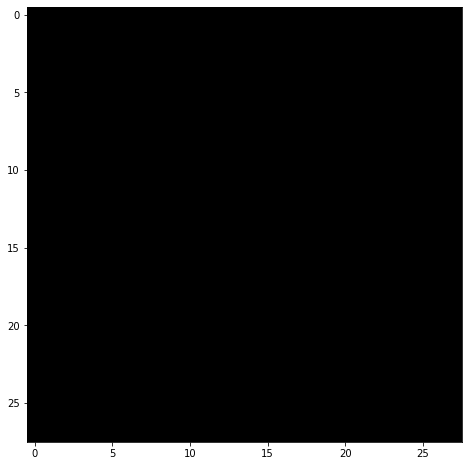

In [38]:
show(by_digits['train_0.jpg'][80])

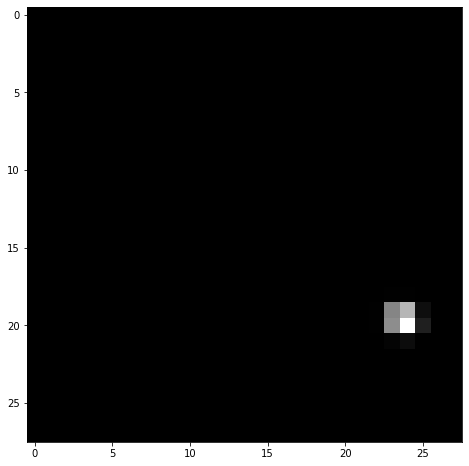

In [39]:
show(by_digits['train_0.jpg'][29])

(28, 28) (576,)


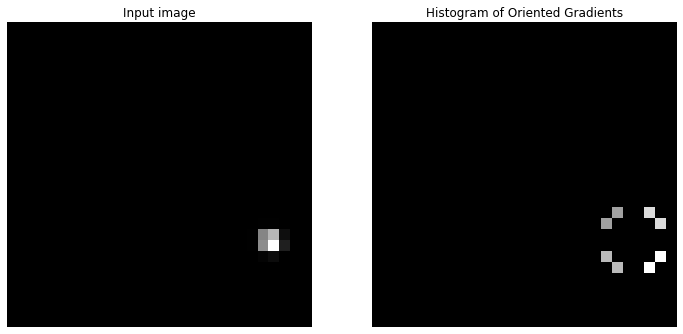

In [40]:
image_resized = resize(by_digits['train_0.jpg'][29], (28, 28),
                       anti_aliasing=True)

fd, hog_image = hog(image_resized, orientations=4, pixels_per_cell=(4, 4),
                cells_per_block=(2, 2), visualize=True)

print(image_resized.shape, fd.shape)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8), sharex=True, sharey=True)

ax1.axis('off')
ax1.imshow(image_resized, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
plt.show()

In [41]:
by_digits

{'train_0.jpg': [array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+

In [42]:
i, train_ds = 0, {}
while i < 9:
    labels = load_tester(f'./train_{i}_digits_0.json').flatten()
    for j in range(81):
        if labels[j] in train_ds.keys():
            train_ds[labels[j]].append(by_digits[f'train_{i}.jpg'][j])
        else:
            lst = []
            train_ds[labels[j]] = [by_digits[f'train_{i}.jpg'][j]]
    i += 1 

In [43]:
train_0

array([[-1, -1,  5, -1,  3, -1, -1, -1, -1],
       [-1, -1, -1,  6, -1,  5,  1,  4,  3],
       [-1, -1, -1, -1,  4,  8,  7, -1,  2],
       [-1, -1, -1, -1, -1,  6, -1, -1,  8],
       [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
       [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
       [-1, -1,  9,  5,  6, -1,  8,  1, -1],
       [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
       [-1,  8, -1,  4, -1,  7,  5, -1, -1]])

In [44]:
x = np.asarray([[-1, -1, 5, -1, 3, -1, -1, -1, -1], [-1, -1, -1, 6, -1, 5, 1, 4, 3], [-1, -1, -1, -1, 4, 8, 7, -1, 2], [-1, -1, -1, -1, -1, 6, -1, -1, 8], [6, -1, -1, -1, -1, 2, 9, -1, 5], [9, -1, -1, 3, -1, 4, 2, -1, -1], [-1, -1, 9, 5, 6, -1, 8, 1, -1], [5, 6, -1, 1, -1, -1, -1, -1, -1], [-1, 8, -1, 4, -1, 7, 5, -1, -1]])

In [45]:
x.flatten()

array([-1, -1,  5, -1,  3, -1, -1, -1, -1, -1, -1, -1,  6, -1,  5,  1,  4,
        3, -1, -1, -1, -1,  4,  8,  7, -1,  2, -1, -1, -1, -1, -1,  6, -1,
       -1,  8,  6, -1, -1, -1, -1,  2,  9, -1,  5,  9, -1, -1,  3, -1,  4,
        2, -1, -1, -1, -1,  9,  5,  6, -1,  8,  1, -1,  5,  6, -1,  1, -1,
       -1, -1, -1, -1, -1,  8, -1,  4, -1,  7,  5, -1, -1])

In [46]:
train_ds[0] = train_ds.pop(-1)

In [47]:
len(train_ds[0])

433

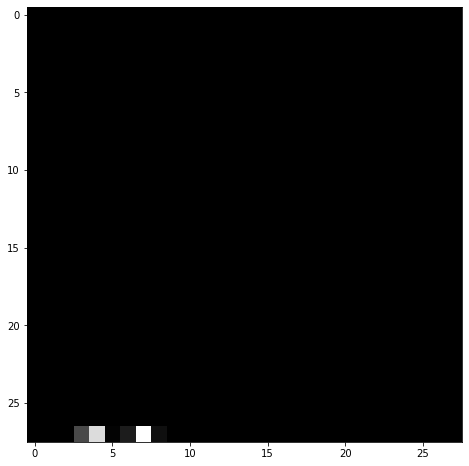

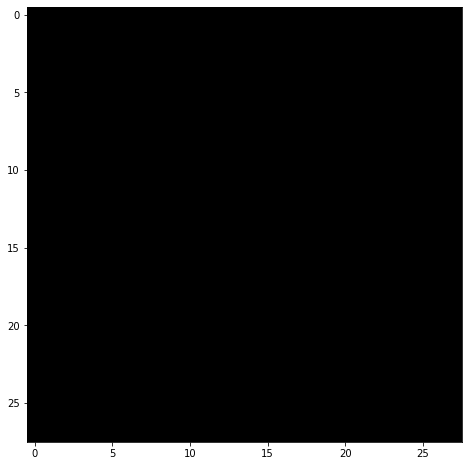

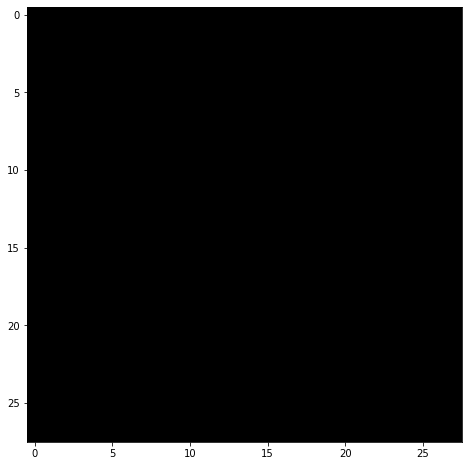

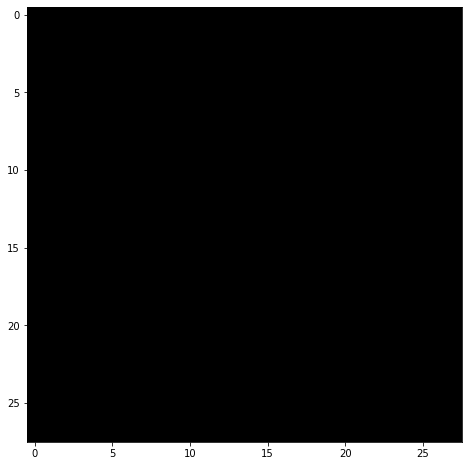

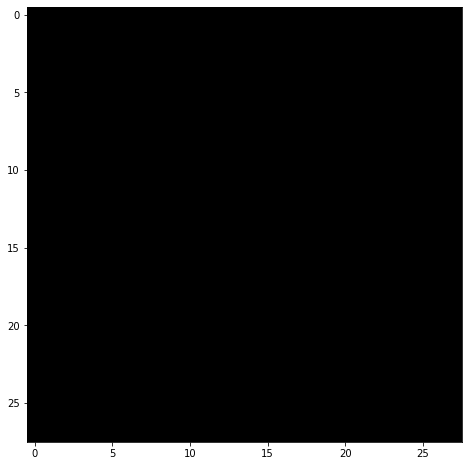

...

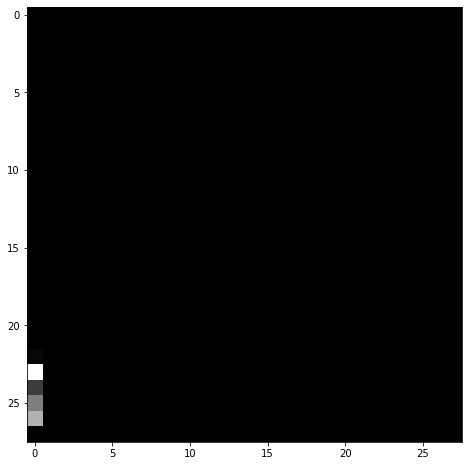

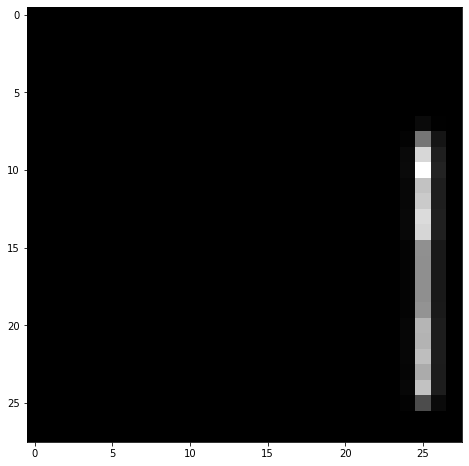

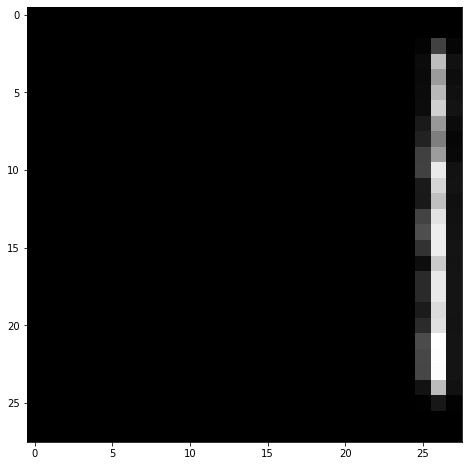

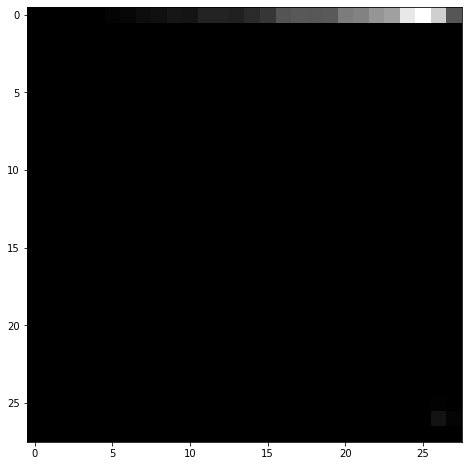

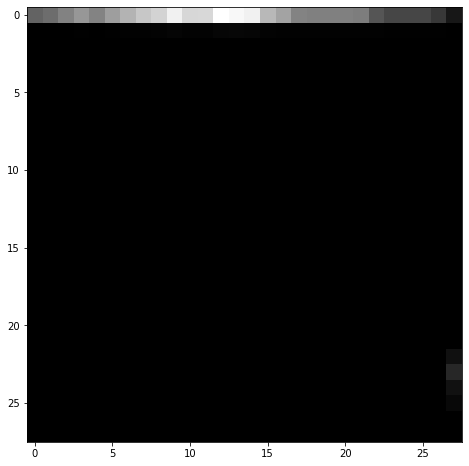

In [48]:
i = 0
while i < 433:
    show(train_ds[0][i])
    i += 1

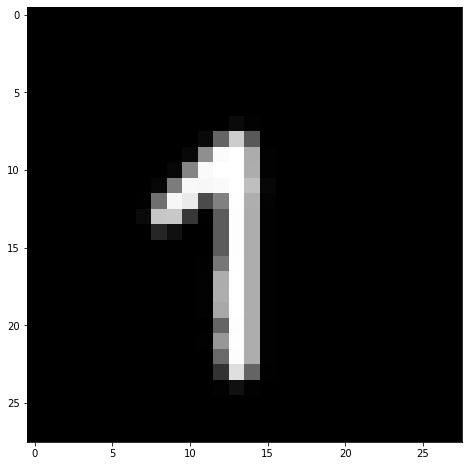

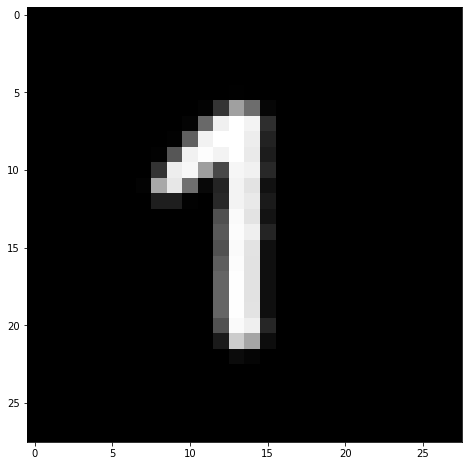

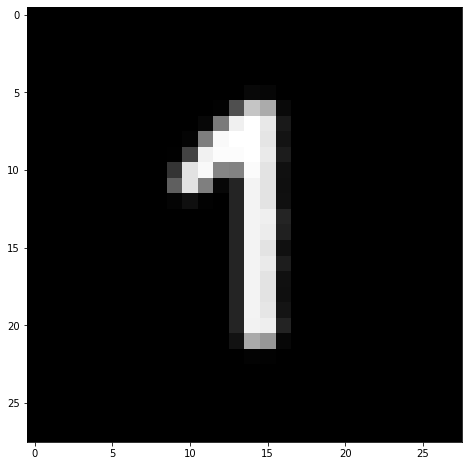

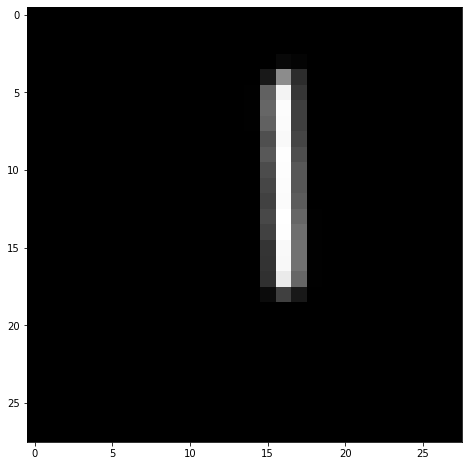

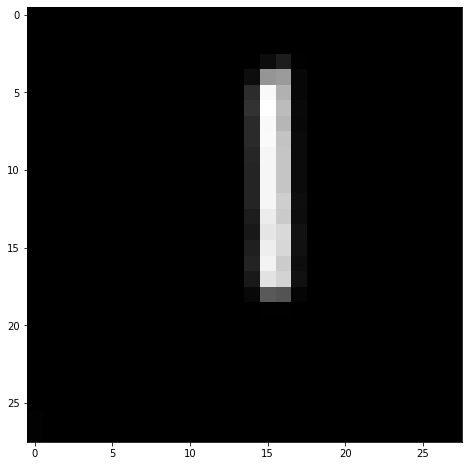

...

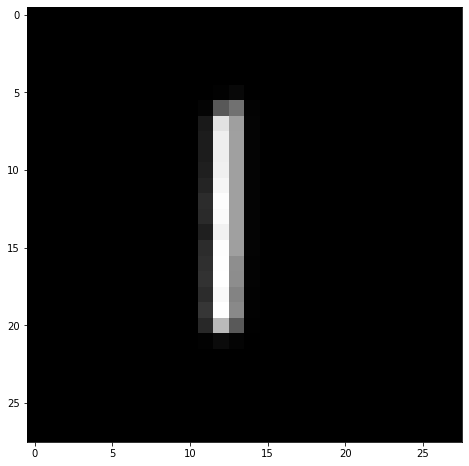

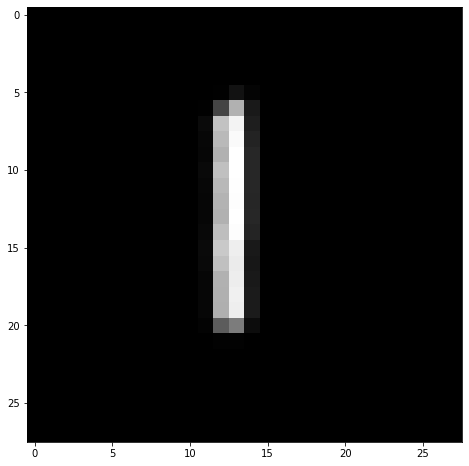

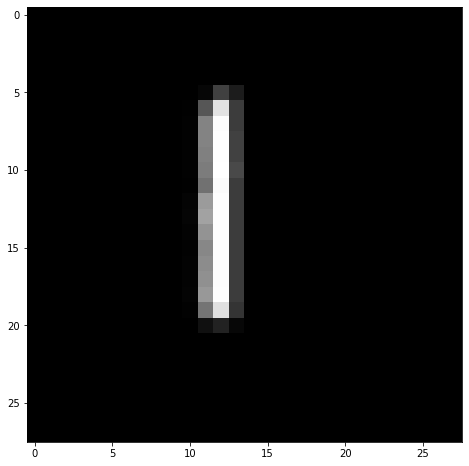

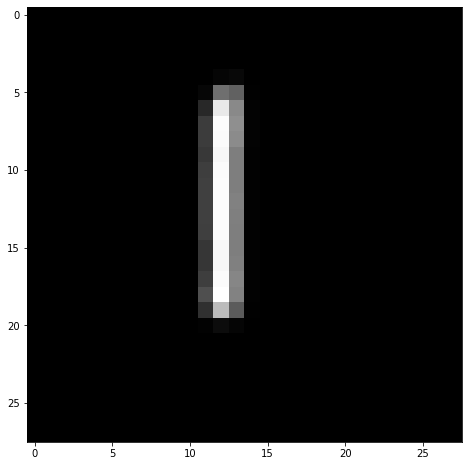

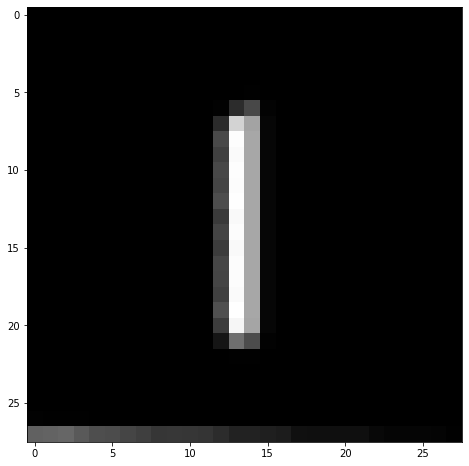

In [49]:
i = 0
while i < 38:
    show(train_ds[1][i])
    i += 1

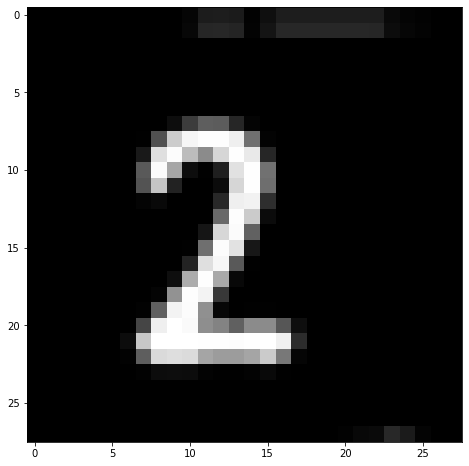

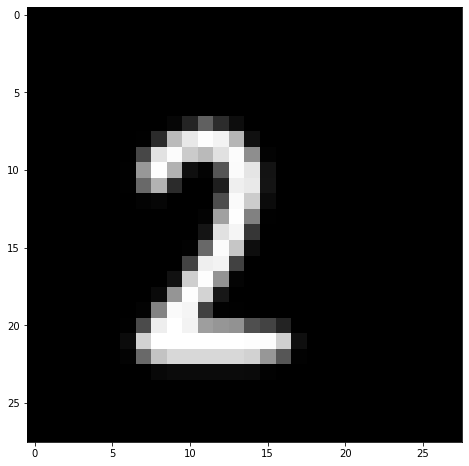

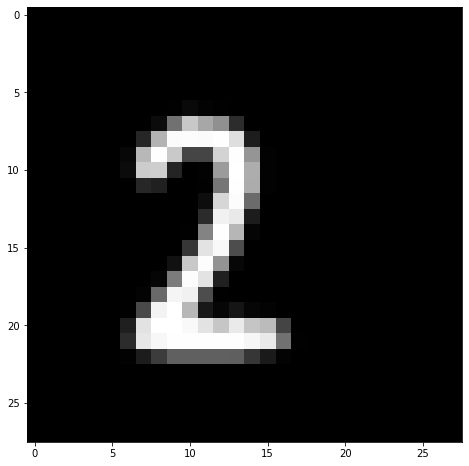

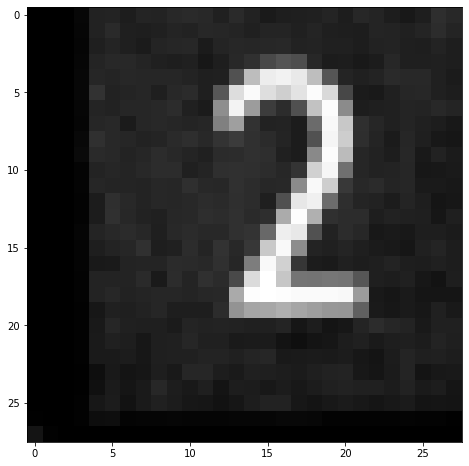

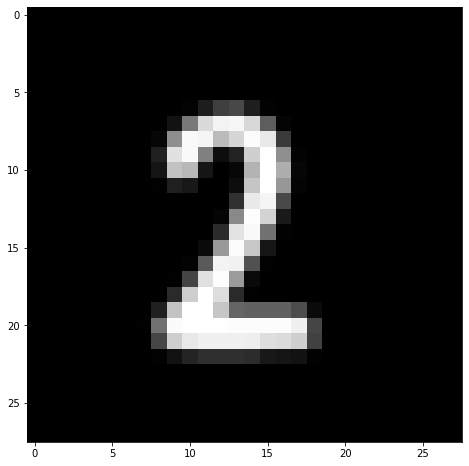

...

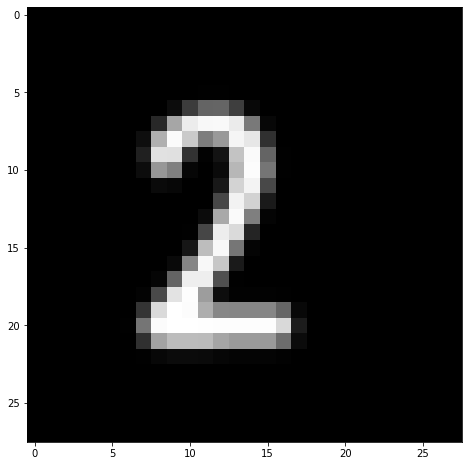

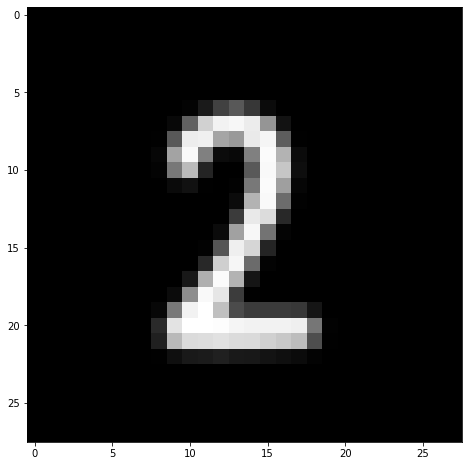

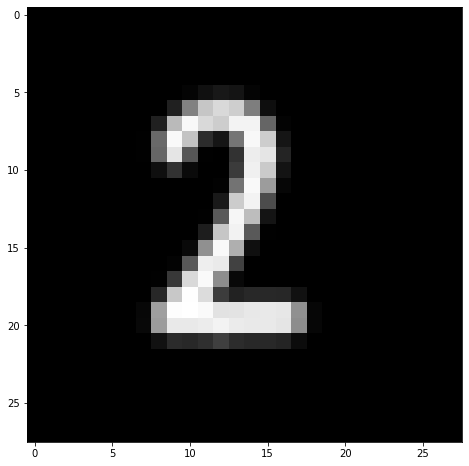

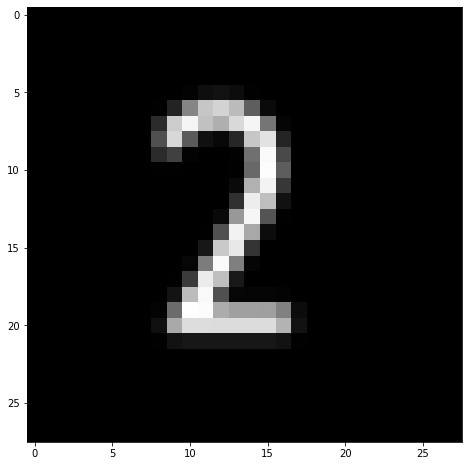

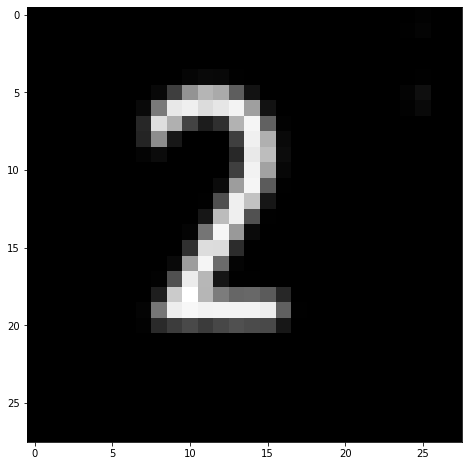

In [50]:
i = 0
while i < 29:
    show(train_ds[2][i])
    i += 1

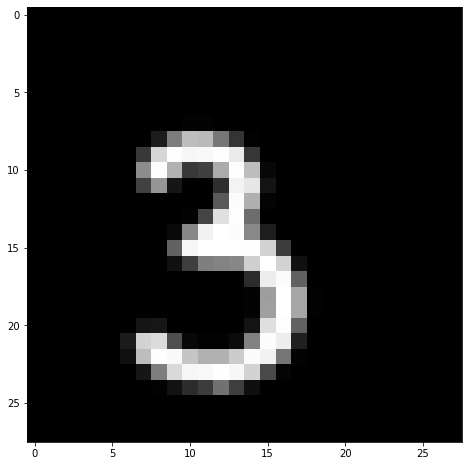

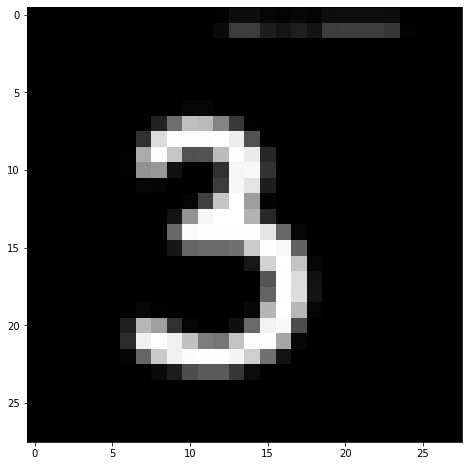

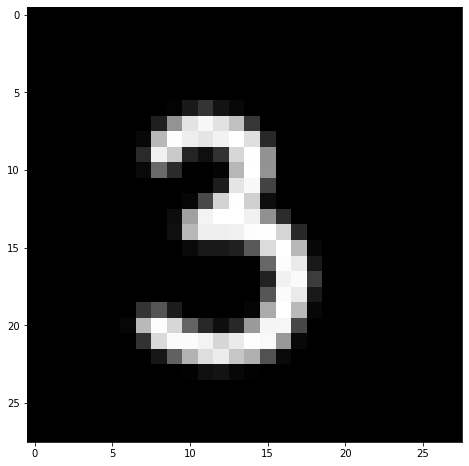

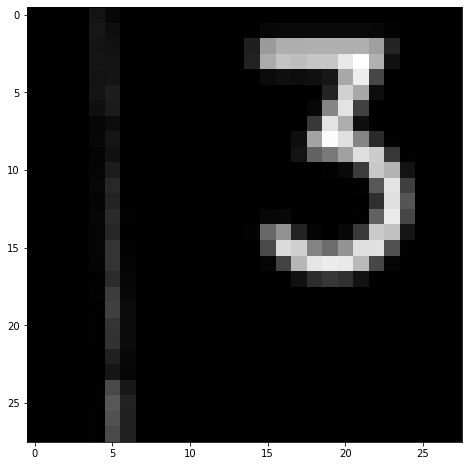

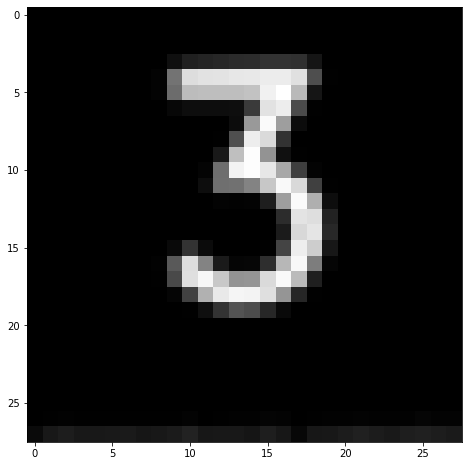

...

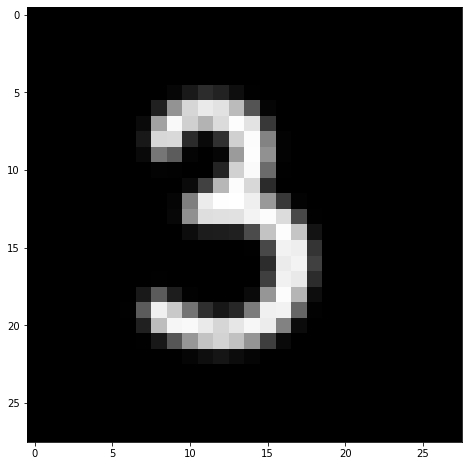

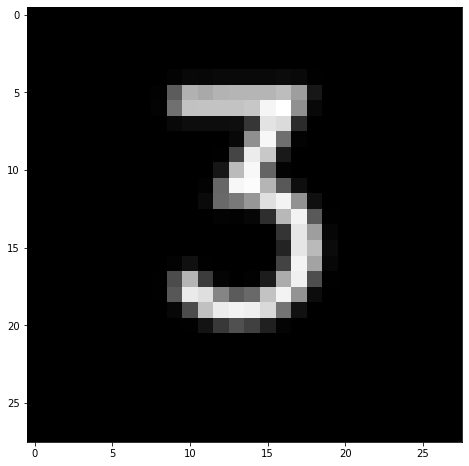

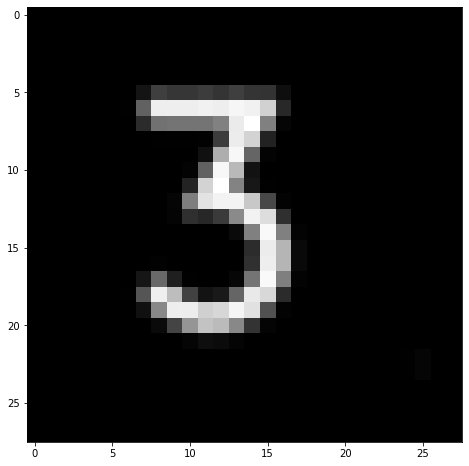

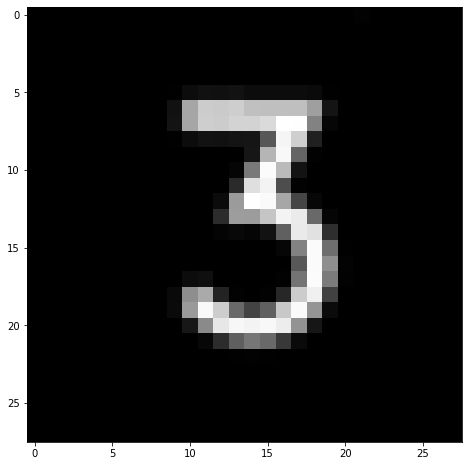

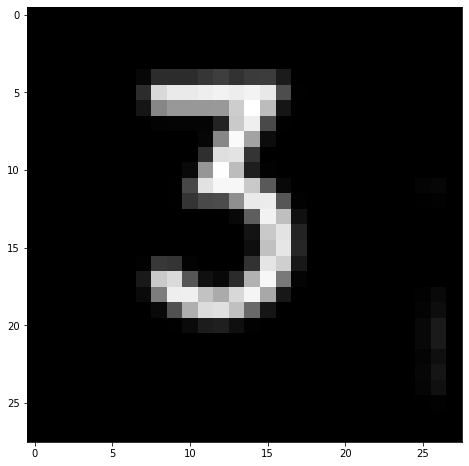

In [51]:
i = 0
while i < 32:
    show(train_ds[3][i])
    i += 1

In [52]:
data = {}
for i in range(0, 10, 1):
    print(len(train_ds[i]))
    data[i] = len(train_ds[i])

433
38
29
32
31
38
35
31
30
32


In [53]:
data = pd.DataFrame(data = data.values(), index=data.keys(), columns=['count'])
data

,count
0,433
1,38
2,29
3,32
4,31
5,38
6,35
7,31
8,30
9,32


In [54]:
from PIL import Image

## create a DS

In [55]:
try:
    os.mkdir(f"./train/")
except:
    pass

for k in train_ds.keys():
    for j in range(len(train_ds[k])):
        
        b = np.linalg.norm(train_ds[k][j])
        norm = train_ds[k][j] / (b + 1e-11)
        img_orig = Image.fromarray((norm*255).astype('uint8'))
        try:
            os.mkdir(f"./train/{k}")
        except:
            pass
        
        img_orig.save(f"./train/{k}/{j}.jpg")

## Oversampling

In [56]:
mask = data['count'] < 1000
data.loc[mask, 'to_add'] = (1000 - data['count']).astype(int)
data.loc[~mask, 'to_add'] = 0
data['from_one_image'] = (np.ceil(data['to_add'] / data['count'])).astype(int)
data

,count,to_add,from_one_image
0,433,567,2
1,38,962,26
2,29,971,34
3,32,968,31
4,31,969,32
5,38,962,26
6,35,965,28
7,31,969,32
8,30,970,33
9,32,968,31


In [126]:
augmenters = {
    'Crop': transforms.Compose([
                                transforms.Resize(size=40, max_size = 45),  #max_size=(30,30)),
                                transforms.CenterCrop(size=40),
                                transforms.RandomCrop(35)
                                ]),
    'Rotate': transforms.RandomRotation(degrees=(-25, 25))
}

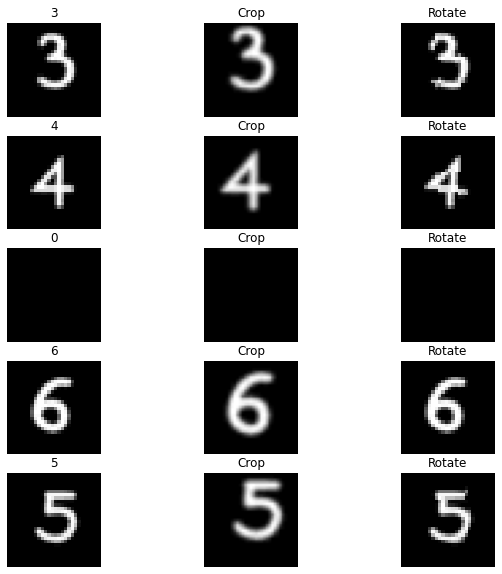

In [127]:
n_examples = 5
train_dataset = train_ds

fig, ax = plt.subplots(nrows=n_examples, ncols=(len(augmenters) + 1),figsize=(10, 10))

for i in range(n_examples):
    key = int(np.random.uniform(0, 10))
    
    b = np.linalg.norm(train_ds[key][int(np.random.uniform(0, 20))])
    norm = train_ds[key][int(np.random.uniform(0, 20))] / (b + 1e-11)
    img_orig = Image.fromarray((norm*255).astype('uint8'))
    img_label = key
    
    
    ax[i][0].imshow(img_orig, cmap='gray')
    ax[i][0].set_title(img_label)
    ax[i][0].axis('off')

    for j, (augmenter_name, augmenter) in enumerate(augmenters.items()):
        img_aug = augmenter(img_orig)
        ax[i][j + 1].imshow(img_aug, cmap='gray')
        ax[i][j + 1].set_title(augmenter_name)
        ax[i][j + 1].axis('off')

In [128]:
data

,count,to_add,from_one_image
0,433,567,2
1,38,962,26
2,29,971,34
3,32,968,31
4,31,969,32
5,38,962,26
6,35,965,28
7,31,969,32
8,30,970,33
9,32,968,31


In [129]:
i = 0
while i < 10:
    
    for h in range(data.to_add[i]):
        augmenter = random.choice(list(augmenters.values()))
        
        
        img = random.choice(train_ds[i])
        b = np.linalg.norm(img)
        norm = img / (b + 1e-11)
        img_orig = Image.fromarray((norm*255).astype('uint8'))
        
        
        aug_img = augmenter(img_orig)
        aug_img.save(f"./train/{i}/{h+data.iloc[i]['count']}.jpg")
        
    i += 1

## creating DataLoader

In [130]:
# разные режимы датасета 
DATA_MODES = ['train', 'val', 'test']
# все изображения будут масштабированы к размеру 28x28 px
RESCALE_SIZE = 224
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

In [131]:
class DigitDataset(Dataset):
    """
    Датасет с картинками, который паралельно подгружает их из папок
    производит скалирование и превращение в торчевые тензоры
    """
    def __init__(self, files, mode):
        super().__init__()
        # список файлов для загрузки
        self.files = sorted(files)
        # режим работы
        self.mode = mode

        if self.mode not in DATA_MODES:
            print(f"{self.mode} is not correct; correct modes: {DATA_MODES}")
            raise NameError

        self.len_ = len(self.files)
     
        self.label_encoder = LabelEncoder()

        if self.mode != 'test':
            self.labels = [path.parent.name for path in self.files]
            self.label_encoder.fit(self.labels)

            with open('label_encoder.pkl', 'wb') as le_dump_file:
                  pickle.dump(self.label_encoder, le_dump_file)
                      
    def __len__(self):
        return self.len_
      
    def load_sample(self, file):
        image = Image.open(file)
        image.load()
        return image
  
    def __getitem__(self, index):
        # для преобразования изображений в тензоры PyTorch и нормализации входа
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,)) 
        ])
        x = self.load_sample(self.files[index])
        x = self._prepare_sample(x)
        x = np.array(x / 255, dtype='float32')
        x = transform(x)
        if self.mode == 'test':
            return x
        else:
            label = self.labels[index]
            label_id = self.label_encoder.transform([label])
            y = label_id.item()
            return x, y
        
    def _prepare_sample(self, image):
        image = image.resize((RESCALE_SIZE, RESCALE_SIZE))
        return np.array(image)

In [132]:
TRAIN_DIR = Path('./train')

train_val_files = sorted(list(TRAIN_DIR.rglob('*.jpg')))

In [133]:
from sklearn.model_selection import train_test_split

train_val_labels = [path.parent.name for path in train_val_files]
train_files, val_files = train_test_split(train_val_files, test_size=0.15, stratify=train_val_labels, random_state=42)

In [134]:
val_dataset = DigitDataset(val_files, mode='val')

## creating NN

In [135]:
class MyCnn(nn.Module):
  
    def __init__(self, n_classes):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=8, kernel_size=3),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Dropout(0.05),
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.conv5 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=96, kernel_size=3),
            nn.BatchNorm2d(96),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.linear = nn.Sequential(
            nn.Flatten(),
            nn.Linear(96 * 5 * 5, 96 * 5 * 5),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(96 * 5 * 5, 96 * 5 * 5),
            nn.ReLU(),
        )
        self.out = nn.Linear(96 * 5 * 5, n_classes)
  
  
    def forward(self, x):
        x = self.conv1(x)
        
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)

        x = self.linear(x)

#         x = x.view(x.size(0), -1)
        logits = self.out(x)
        return logits

In [136]:
def fit_epoch(model, train_loader, criterion, optimizer):
    running_loss = 0.0
    running_corrects = 0
    processed_data = 0
  
    for inputs, labels in train_loader:
        inputs = inputs.to(DEVICE)
        labels = labels.to(DEVICE)
        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        preds = torch.argmax(outputs, 1)
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
        processed_data += inputs.size(0)
              
    train_loss = running_loss / processed_data
    train_acc = running_corrects.cpu().numpy() / processed_data
    return train_loss, train_acc

In [137]:
def eval_epoch(model, val_loader, criterion):
    model.eval()
    running_loss = 0.0
    running_corrects = 0
    processed_size = 0

    for inputs, labels in val_loader:
        inputs = inputs.to(DEVICE)
        labels = labels.to(DEVICE)

        with torch.set_grad_enabled(False):
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            preds = torch.argmax(outputs, 1)

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
        processed_size += inputs.size(0)
    val_loss = running_loss / processed_size
    val_acc = running_corrects.double() / processed_size
    return val_loss, val_acc

In [138]:
def train(train_dataset, val_dataset, model, epochs, batch_size):
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    history = []
    log_template = "\nEpoch {ep:03d} train_loss: {t_loss:0.4f} \
    val_loss {v_loss:0.4f} train_acc {t_acc:0.4f} val_acc {v_acc:0.4f}"
    opt = torch.optim.AdamW(model.parameters())
    criterion = nn.CrossEntropyLoss()
    
    with tqdm(desc="epoch", total=epochs) as pbar_outer:
        for epoch in range(epochs):
            train_loss, train_acc = fit_epoch(model, train_loader, criterion, opt)
            #print("loss", train_loss)
            
            val_loss, val_acc = eval_epoch(model, val_loader, criterion)
            history.append((train_loss, train_acc, val_loss, val_acc))
            
            pbar_outer.update(1)
            tqdm.write(log_template.format(ep=epoch+1, t_loss=train_loss,\
                                           v_loss=val_loss, t_acc=train_acc, v_acc=val_acc))
            
    return history

In [139]:
def predict(model, test_loader):
    with torch.no_grad():
        logits = []
    
        for inputs in test_loader:
            inputs = inputs.to(DEVICE)
            model.eval()
            outputs = model(inputs).cpu()
            logits.append(outputs)
            
    probs = nn.functional.softmax(torch.cat(logits), dim=-1).numpy()
    return probs

In [140]:
n_classes = len(np.unique(train_val_labels))
simple_cnn = MyCnn(n_classes).to(DEVICE)
print(f"we will classify: {n_classes}")
print(simple_cnn)

we will classify: 11
MyCnn(
  (conv1): Sequential(
    (0): Conv2d(1, 8, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv2): Sequential(
    (0): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Dropout(p=0.05, inplace=False)
  )
  (conv3): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv4): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(64, eps=

In [141]:
train_val_files = sorted(list(TRAIN_DIR.rglob('*.jpg')))
train_val_labels = [path.parent.name for path in train_val_files]
train_files, _ = train_test_split(train_val_files, test_size=0.15, stratify=train_val_labels, random_state=42)

val_dataset = DigitDataset(val_files, mode='val')
    
train_dataset = DigitDataset(train_files, mode='train')

## Learning

In [142]:
history = train(train_dataset, val_dataset, model=simple_cnn, epochs=8, batch_size=32)

epoch:  12%|█████████▌                                                                  | 1/8 [02:11<15:22, 131.83s/it]


Epoch 001 train_loss: 0.4917     val_loss 0.3566 train_acc 0.8546 val_acc 0.9121


epoch:  25%|███████████████████                                                         | 2/8 [04:13<12:34, 125.78s/it]


Epoch 002 train_loss: 0.3876     val_loss 0.0887 train_acc 0.9157 val_acc 0.9835


epoch:  38%|████████████████████████████▌                                               | 3/8 [06:32<10:59, 131.96s/it]


Epoch 003 train_loss: 0.0757     val_loss 0.0752 train_acc 0.9848 val_acc 0.9868


epoch:  50%|██████████████████████████████████████                                      | 4/8 [08:57<09:08, 137.09s/it]


Epoch 004 train_loss: 0.0520     val_loss 0.0707 train_acc 0.9910 val_acc 0.9848


epoch:  62%|███████████████████████████████████████████████▌                            | 5/8 [11:22<06:59, 140.00s/it]


Epoch 005 train_loss: 0.0463     val_loss 0.0718 train_acc 0.9909 val_acc 0.9907


epoch:  75%|█████████████████████████████████████████████████████████                   | 6/8 [13:45<04:42, 141.03s/it]


Epoch 006 train_loss: 0.0451     val_loss 0.0826 train_acc 0.9915 val_acc 0.9907


epoch:  88%|██████████████████████████████████████████████████████████████████▌         | 7/8 [16:13<02:23, 143.05s/it]


Epoch 007 train_loss: 0.0842     val_loss 0.0979 train_acc 0.9804 val_acc 0.9835


epoch: 100%|████████████████████████████████████████████████████████████████████████████| 8/8 [18:35<00:00, 139.42s/it]


Epoch 008 train_loss: 0.0550     val_loss 0.0872 train_acc 0.9888 val_acc 0.9901


In [143]:
loss, acc, val_loss, val_acc = zip(*history)

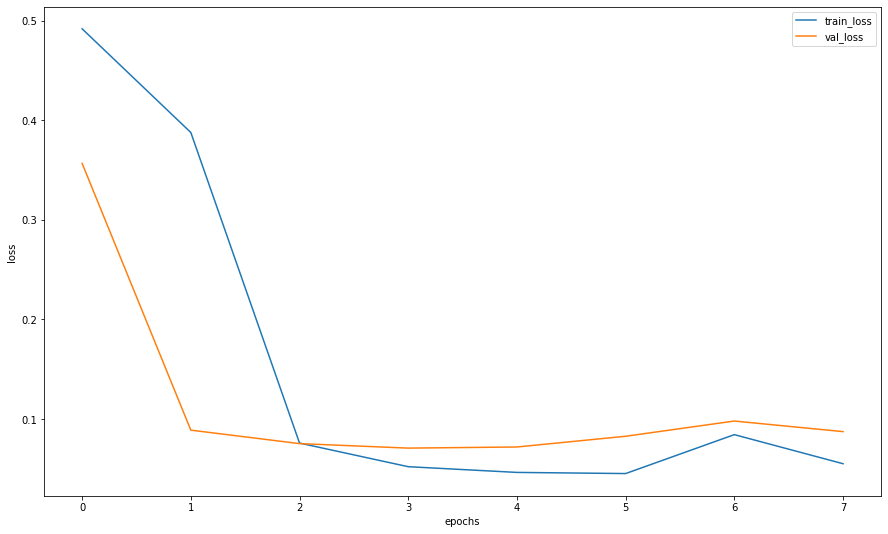

In [144]:
plt.figure(figsize=(15, 9))
plt.plot(loss, label="train_loss")
plt.plot(val_loss, label="val_loss")
plt.legend(loc='best') 
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


In [145]:
def predict_one_sample(model, inputs, device=DEVICE):
    """Предсказание, для одной картинки"""
    with torch.no_grad():
        inputs = inputs.to(device)
        model.eval()
        logit = model(inputs).cpu()
        probs = torch.nn.functional.softmax(logit, dim=-1).numpy()
    return probs

In [146]:
random_characters = int(np.random.uniform(0,1000))
ex_img, true_label = val_dataset[random_characters]
probs_im = predict_one_sample(simple_cnn, ex_img.unsqueeze(0))

In [147]:
probs_im

array([[8.3995154e-08, 4.0861745e-10, 3.9105429e-12, 1.6284540e-08,
        1.9745724e-11, 9.9999475e-01, 2.4628937e-06, 6.2087629e-13,
        2.2839328e-09, 5.2209309e-12, 2.6659959e-06]], dtype=float32)

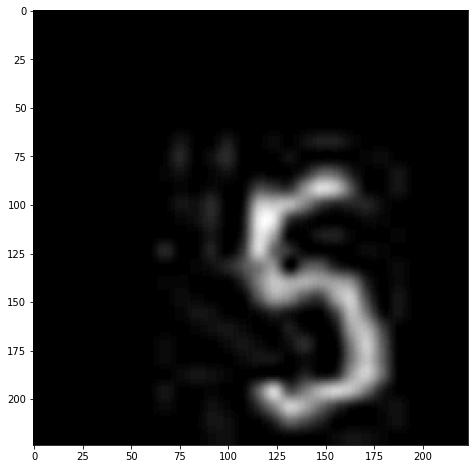

In [148]:
show(ex_img[0])

In [149]:
idxs = list(map(int, np.random.uniform(0,1000, 20)))
imgs = [val_dataset[id][0].unsqueeze(0) for id in idxs]

probs_ims = predict(simple_cnn, imgs)

In [150]:
label_encoder = pickle.load(open("label_encoder.pkl", 'rb'))
print(label_encoder.classes_)

['0' '1' '2' '3' '4' '5' '6' '7' '8' '9' 'testDL']


In [151]:
y_pred = np.argmax(probs_ims,-1)

actual_labels = [val_dataset[id][1] for id in idxs]

preds_class = [label_encoder.classes_[i] for i in y_pred]

In [152]:
actual_labels

[6, 5, 3, 6, 0, 1, 0, 2, 2, 1, 5, 2, 1, 3, 0, 5, 0, 6, 5, 1]

In [153]:
from sklearn.metrics import f1_score
print(actual_labels)
print(y_pred)
f1_score(actual_labels, y_pred,average='micro')

[6, 5, 3, 6, 0, 1, 0, 2, 2, 1, 5, 2, 1, 3, 0, 5, 0, 6, 5, 1]
[6 5 3 6 0 1 0 2 2 1 5 2 7 3 0 5 0 6 5 1]


0.9500000000000001

In [154]:
trans1 = transforms.ToTensor()

In [155]:
b = np.linalg.norm(train_ds[4][0])
norm = train_ds[4][0] / (b + 1e-11)
img_orig = Image.fromarray((norm*255).astype('uint8'))
img_for_pred = img_orig.resize((RESCALE_SIZE, RESCALE_SIZE))
fr_pr = trans1(img_for_pred)

In [156]:
b = np.linalg.norm(train_ds[5][0])
norm = train_ds[5][0] / (b + 1e-11)
img_orig = Image.fromarray((norm*255).astype('uint8'))
img_for_pred2 = img_orig.resize((RESCALE_SIZE, RESCALE_SIZE))


In [157]:
fr_pr = trans1(img_for_pred)

In [158]:
fr_pr.shape

torch.Size([1, 224, 224])

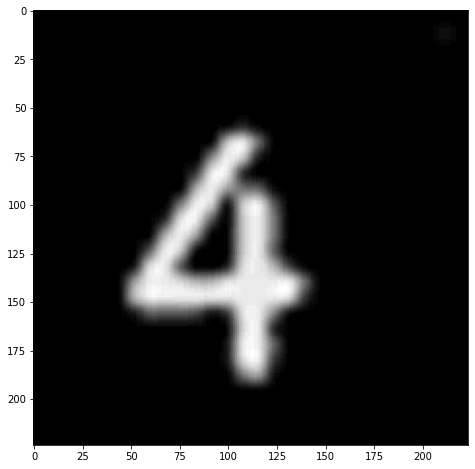

In [159]:
show(fr_pr[0])

In [160]:
probs_im = predict_one_sample(simple_cnn, fr_pr.unsqueeze(0))

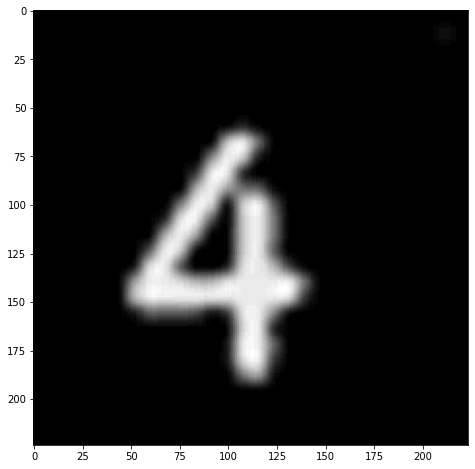

In [161]:
show(fr_pr.unsqueeze(1)[0][0])

In [162]:
probs_im

array([[8.8541546e-22, 7.2493934e-12, 3.0668754e-24, 9.7642886e-26,
        9.9838126e-01, 1.0837748e-21, 1.6187339e-03, 5.0207379e-21,
        1.5575270e-11, 1.0981745e-13, 3.7717364e-14]], dtype=float32)

In [163]:
y_pred = np.argmax(probs_im,-1)

In [164]:
y_pred

array([4], dtype=int64)

In [165]:
preds_class = [label_encoder.classes_[i] for i in y_pred]

In [166]:
preds_class

['4']

In [167]:
TEST_DIR = Path('./test')
test_files = sorted(list(TEST_DIR.rglob('*.jpg')))

In [168]:
test_dataset = DigitDataset(test_files, mode="test")
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=64)
probs = predict(simple_cnn, test_loader)


preds = label_encoder.inverse_transform(np.argmax(probs, axis=1))
test_filenames = [path.name for path in test_dataset.files]

In [169]:
import pandas as pd
my_submit = pd.DataFrame({'Id': test_filenames, 'Expected': preds})
my_submit.head()

,Id,Expected
0,0.0.jpg,0
1,0.1.jpg,0
2,0.2.jpg,5
3,0.3.jpg,0
4,0.4.jpg,3


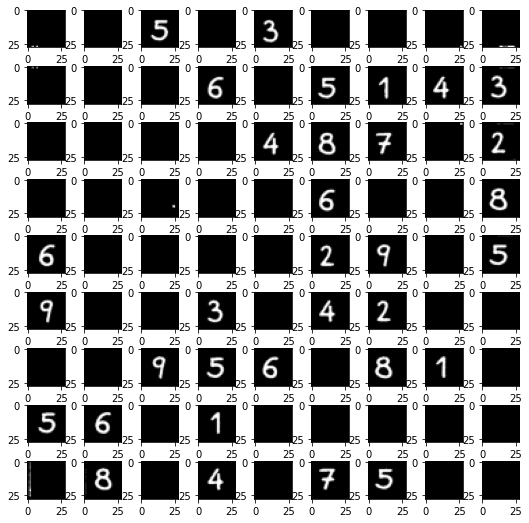

In [170]:
ploy_by_digits(by_digits['train_0.jpg'])

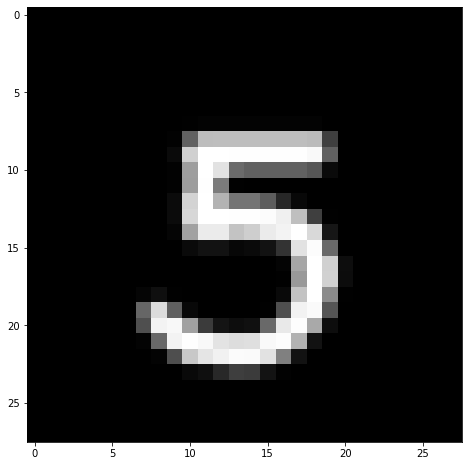

In [171]:
show(by_digits['train_0.jpg'][2])

In [172]:
try:
    os.mkdir(f'./test')
except:
    pass
for j in range(9):
    try:
        os.mkdir(f'./test/train_{j}')
    except:
        pass
    i = 0
    while i < len(by_digits[f'train_{j}.jpg']):
    
        b = np.linalg.norm(by_digits[f'train_{j}.jpg'][i])
        norm = by_digits[f'train_{j}.jpg'][i] / (b + 1e-11)
        img_orig = Image.fromarray((norm*255).astype('uint8'))
        
        
        img_orig.save(f"./test/train_{j}/{i/10}.jpg")
        i += 1

In [173]:
TEST_DIR = Path('./test/train_0')
test_files = sorted(list(TEST_DIR.rglob('*.jpg')), reverse = False)

In [174]:
test_dataset = DigitDataset(test_files, mode="test")
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=1)
probs = predict(simple_cnn, test_loader)


preds = label_encoder.inverse_transform(np.argmax(probs, axis=1))
test_filenames = [path.name for path in test_dataset.files]

In [175]:
int_pred = []
for i in range(len(preds)):
    if preds[i] == '0':
        
        int_pred.append(int(-1))
    else:
        int_pred.append(int(preds[i]))

In [176]:
digits = np.array(int_pred).reshape((1, 9, 9))

In [177]:
digits.shape

(1, 9, 9)

In [180]:
digits == digits_th

array([[[ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True]]])

In [181]:
digits

array([[[-1, -1,  5, -1,  3, -1, -1, -1, -1],
        [-1, -1, -1,  6, -1,  5,  1,  4,  3],
        [-1, -1, -1, -1,  4,  8,  7, -1,  2],
        [-1, -1, -1, -1, -1,  6, -1, -1,  8],
        [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
        [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
        [-1, -1,  9,  5,  6, -1,  8,  1, -1],
        [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
        [-1,  8, -1,  4, -1,  7,  5, -1, -1]]])

In [182]:
train_0

array([[-1, -1,  5, -1,  3, -1, -1, -1, -1],
       [-1, -1, -1,  6, -1,  5,  1,  4,  3],
       [-1, -1, -1, -1,  4,  8,  7, -1,  2],
       [-1, -1, -1, -1, -1,  6, -1, -1,  8],
       [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
       [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
       [-1, -1,  9,  5,  6, -1,  8,  1, -1],
       [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
       [-1,  8, -1,  4, -1,  7,  5, -1, -1]])

In [183]:
digits == train_0

array([[[ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True],
        [ True,  True,  True,  True,  True,  True,  True,  True,  True]]])

In [184]:
np.unique(preds, return_counts=True)

(array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype='<U6'),
 array([48,  3,  3,  3,  4,  6,  5,  2,  4,  3], dtype=int64))

In [185]:
np.unique(train_0, return_counts=True)

(array([-1,  1,  2,  3,  4,  5,  6,  7,  8,  9]),
 array([48,  3,  3,  3,  4,  6,  5,  2,  4,  3], dtype=int64))

In [186]:
train_0.shape

(9, 9)

In [187]:
preds.reshape(9,9)

array([['0', '0', '5', '0', '3', '0', '0', '0', '0'],
       ['0', '0', '0', '6', '0', '5', '1', '4', '3'],
       ['0', '0', '0', '0', '4', '8', '7', '0', '2'],
       ['0', '0', '0', '0', '0', '6', '0', '0', '8'],
       ['6', '0', '0', '0', '0', '2', '9', '0', '5'],
       ['9', '0', '0', '3', '0', '4', '2', '0', '0'],
       ['0', '0', '9', '5', '6', '0', '8', '1', '0'],
       ['5', '6', '0', '1', '0', '0', '0', '0', '0'],
       ['0', '8', '0', '4', '0', '7', '5', '0', '0']], dtype='<U6')

## ploting

In [190]:
def plot_solved_sudoku(path_to_img):
    img = cv2.imread(path_to_img)
    out_bol, digits = predict_image(img)
    return digits

In [210]:
digits

array([[[-1, -1,  5, -1,  3, -1, -1, -1, -1],
        [-1, -1, -1,  6, -1,  5,  1,  4,  3],
        [-1, -1, -1, -1,  4,  8,  7, -1,  2],
        [-1, -1, -1, -1, -1,  6, -1, -1,  8],
        [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
        [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
        [-1, -1,  9,  5,  6, -1,  8,  1, -1],
        [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
        [-1,  8, -1,  4, -1,  7,  5, -1, -1]]])

In [191]:
plot_solved_sudoku('./train_0.jpg')

array([[[-1, -1,  5, -1,  3, -1, -1, -1, -1],
        [-1, -1, -1,  6, -1,  5,  1,  4,  3],
        [-1, -1, -1, -1,  4,  8,  7, -1,  2],
        [-1, -1, -1, -1, -1,  6, -1, -1,  8],
        [ 6, -1, -1, -1, -1,  2,  9, -1,  5],
        [ 9, -1, -1,  3, -1,  4,  2, -1, -1],
        [-1, -1,  9,  5,  6, -1,  8,  1, -1],
        [ 5,  6, -1,  1, -1, -1, -1, -1, -1],
        [-1,  8, -1,  4, -1,  7,  5, -1, -1]]])

In [201]:
! git clone https://github.com/maxme1/sudoku.git

fatal: destination path 'sudoku' already exists and is not an empty directory.


In [212]:
from solver import solve, print_field, print_solutions

In [220]:
digits_for_solve = digits.reshape(9, 9).astype(float)

In [221]:
digits_for_solve[digits_for_solve == -1] = np.nan

In [222]:
digits_for_solve

array([[nan, nan,  5., nan,  3., nan, nan, nan, nan],
       [nan, nan, nan,  6., nan,  5.,  1.,  4.,  3.],
       [nan, nan, nan, nan,  4.,  8.,  7., nan,  2.],
       [nan, nan, nan, nan, nan,  6., nan, nan,  8.],
       [ 6., nan, nan, nan, nan,  2.,  9., nan,  5.],
       [ 9., nan, nan,  3., nan,  4.,  2., nan, nan],
       [nan, nan,  9.,  5.,  6., nan,  8.,  1., nan],
       [ 5.,  6., nan,  1., nan, nan, nan, nan, nan],
       [nan,  8., nan,  4., nan,  7.,  5., nan, nan]])

In [245]:
list(solve(digits_for_solve))

[array([[7, 4, 5, 2, 3, 1, 6, 8, 9],
        [8, 9, 2, 6, 7, 5, 1, 4, 3],
        [3, 1, 6, 9, 4, 8, 7, 5, 2],
        [2, 5, 1, 7, 9, 6, 4, 3, 8],
        [6, 3, 4, 8, 1, 2, 9, 7, 5],
        [9, 7, 8, 3, 5, 4, 2, 6, 1],
        [4, 2, 9, 5, 6, 3, 8, 1, 7],
        [5, 6, 7, 1, 8, 9, 3, 2, 4],
        [1, 8, 3, 4, 2, 7, 5, 9, 6]], dtype=int64)]

In [247]:
next(solve(digits_for_solve)).shape

(9, 9)

In [252]:
solved_list = next(solve(digits_for_solve)).reshape(-1)

In [253]:
solved_list

array([7, 4, 5, 2, 3, 1, 6, 8, 9, 8, 9, 2, 6, 7, 5, 1, 4, 3, 3, 1, 6, 9,
       4, 8, 7, 5, 2, 2, 5, 1, 7, 9, 6, 4, 3, 8, 6, 3, 4, 8, 1, 2, 9, 7,
       5, 9, 7, 8, 3, 5, 4, 2, 6, 1, 4, 2, 9, 5, 6, 3, 8, 1, 7, 5, 6, 7,
       1, 8, 9, 3, 2, 4, 1, 8, 3, 4, 2, 7, 5, 9, 6], dtype=int64)

In [287]:
full_sudoku = []
for i in solved_list:
    full_sudoku.append(train_ds[i][0])

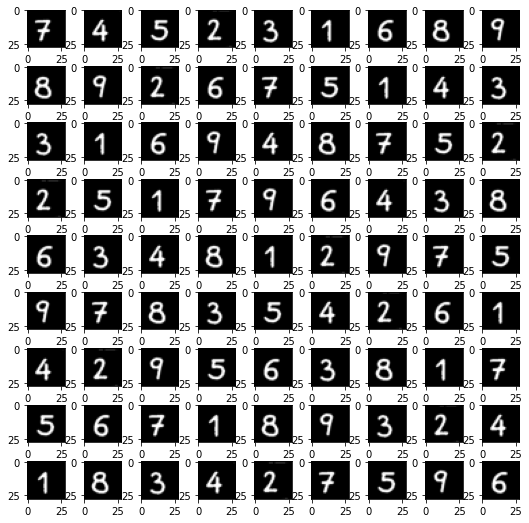

In [288]:
ploy_by_digits(full_sudoku)

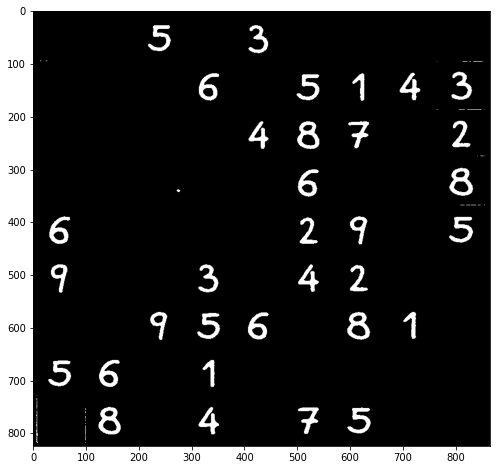

In [350]:
show(photos[f'train_0.jpg'])

In [420]:
whole_pic = np.zeros(shape=(252,252))
k = 0
for i in range(28, 253, 28):
    for j in range(28, 253, 28):
        whole_pic[(i-28):i, (j-28):j] = full_sudoku[k]
        k += 1

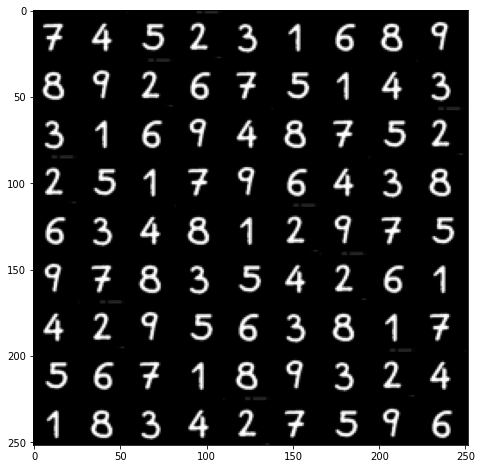

In [421]:
show(whole_pic)

In [776]:
img_gray.shape

(2517, 2976)

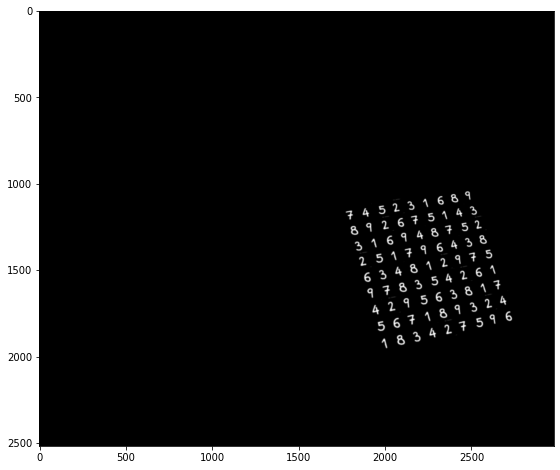

In [777]:
resized = cv2.resize(whole_pic, (img_gray.shape[-1], img_gray.shape[0]))
ordered = sorted(approx, key=lambda x: x[0][0] + x[0][1])
l_u, r_d = ordered[0][0], ordered[-1][0]
r_u, l_d = ordered[1][0], ordered[2][0]
if r_u[1] > l_d[1]:
    r_u, l_d = l_d, r_u
pts1 = np.float32([l_u, l_d, r_u, r_d])
pts2 = np.float32([[0, 0], [0, 2517], [2976, 0], [2976, 2517]])
matrix = cv2.getPerspectiveTransform(pts2, pts1)
result = cv2.warpPerspective(resized, matrix, (2976, 2517))
show(result)

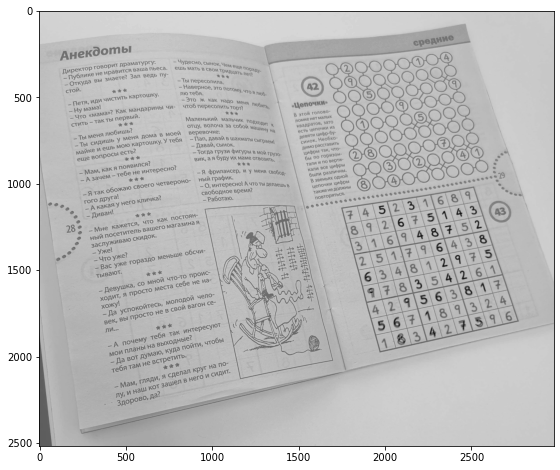

In [778]:
sudoku_plotted = img_gray/30 + (300- result*1000)

show(sudoku_plotted)